## Instalación

In [ ]:
!pip install pyclustering

In [ ]:
!pip install tslearn

In [ ]:
!pip install yellowbrick

In [ ]:
pip install -U scikit-fuzzy

In [ ]:
!pip install validclust

## Import

In [ ]:
# Importar los datos desde el github del proyecto
!wget --no-cache -O init.py -q https://raw.githubusercontent.com/Astorress/especializacion-analitica-monografia/v2/init.py

import init;
init.init(force_download=False);

In [ ]:
import datetime as dt

import pandas as pd
import numpy as np

import matplotlib.pyplot as plt
from mpl_toolkits.mplot3d import Axes3D
import plotly.express as px
import seaborn as sns

from sklearn.preprocessing import MinMaxScaler, StandardScaler

from sklearn.cluster import KMeans
from sklearn.cluster import DBSCAN
from sklearn.cluster import SpectralClustering
import skfuzzy as fuzz
from sklearn.cluster import MeanShift

from sklearn.metrics import pairwise_distances
from sklearn.metrics import silhouette_score, silhouette_samples, adjusted_rand_score
from sklearn.metrics import calinski_harabasz_score
from sklearn.metrics import silhouette_score
from sklearn.metrics import davies_bouldin_score
from validclust.indices import dunn
from yellowbrick.cluster import KElbowVisualizer

from scipy.stats import spearmanr
from scipy.cluster import hierarchy
from scipy.spatial.distance import mahalanobis
from scipy.spatial.distance import pdist

# pyclustering kmeans
from pyclustering.cluster.kmeans import kmeans as kmeans_
from pyclustering.utils.metric import distance_metric
from pyclustering.cluster.center_initializer import random_center_initializer
from pyclustering.cluster.encoder import type_encoding
from pyclustering.cluster.encoder import cluster_encoder
from pyclustering.cluster.center_initializer import kmeans_plusplus_initializer
from pyclustering.utils.metric import type_metric, distance_metric

# PCA
from sklearn.decomposition import PCA

import warnings
warnings.filterwarnings('ignore')

pd.set_option('display.max_columns', 50)

In [ ]:
import statsmodels.api as sm

from statsmodels.graphics.tsaplots import plot_acf
from statsmodels.graphics.tsaplots import plot_pacf

from pylab import rcParams

## Analisis de datos

In [ ]:
# Lectura del archivo con los consumos de energia electrica y temperatura de antioquia
data_consumo = pd.read_csv('/content/data/data_procesada.csv')

# Procesamiento de las columnas existentes en el dataset
data_consumo['fecha_hora'] = pd.to_datetime(data_consumo['fecha_hora'])

data_consumo = data_consumo.astype({'consumo': int, 'hora': int, 'mes': int, 'dia_semana': int, 'fin_de_semana': int, 'festivos': int,
                                    'tipo_dia': int, 'tipo_semana': int, 'temperatura_mediana': float, 'temperatura_prom': float, 'temperatura_max': float})

data_consumo = data_consumo.dropna()

data_consumo

,fecha_hora,consumo,hora,mes,dia_semana,fin_de_semana,festivos,tipo_dia,tipo_semana,temperatura_mediana,temperatura_prom,temperatura_max
0,2015-01-01 00:00:00,874902,0,1,4,0,1,1,2,20.800,19.250000,21.3
1,2015-01-01 01:00:00,811130,1,1,4,0,1,1,2,20.700,18.900000,20.8
2,2015-01-01 02:00:00,768748,2,1,4,0,1,1,2,20.400,18.683333,20.5
3,2015-01-01 03:00:00,744469,3,1,4,0,1,1,2,20.200,18.566667,20.4
4,2015-01-01 04:00:00,735272,4,1,4,0,1,1,2,19.700,18.216667,19.9
...,...,...,...,...,...,...,...,...,...,...,...,...
76387,2023-09-18 19:00:00,1651808,19,9,1,0,0,1,1,21.375,21.440000,25.7
76388,2023-09-18 20:00:00,1590831,20,9,1,0,0,1,1,20.500,20.151667,24.3
76389,2023-09-18 21:00:00,1465352,21,9,1,0,0,1,1,19.650,19.558750,23.3
76390,2023-09-18 22:00:00,1338550,22,9,1,0,0,1,1,18.850,18.938333,22.7


### Correlación entre la temperatura y el consumo

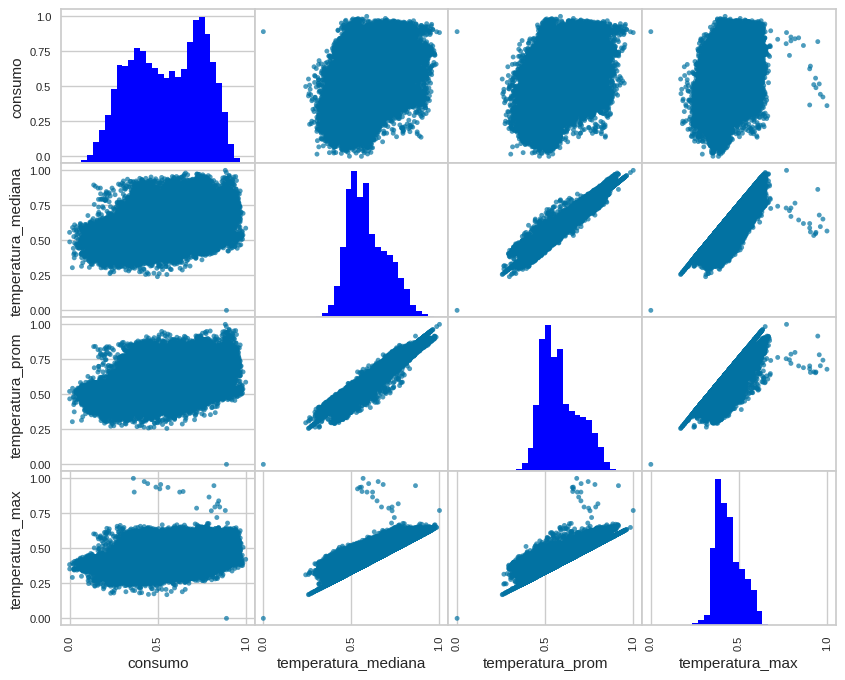

In [ ]:
data_consumo_normalizada = data_consumo[['consumo', 'temperatura_mediana', 'temperatura_prom', 'temperatura_max']]
data_consumo_normalizada = (data_consumo_normalizada - data_consumo_normalizada.min())/(data_consumo_normalizada.max() - data_consumo_normalizada.min())

pd.plotting.scatter_matrix(data_consumo_normalizada, alpha=0.7, figsize=(10, 8), range_padding = 0.1, diagonal='hist',
                            hist_kwds = {'bins':30, 'color':'blue'})
plt.show()

In [ ]:
spearman = []
valor_p = []
data = data_consumo_normalizada.values
data = np.asarray(data)

for _,n in enumerate(np.arange(0,data.shape[1])):
  for _,m in enumerate(np.arange(0,data.shape[1])):
      s_valor, p_valor = spearmanr(data[:,n], data[:,m])
      spearman.append(s_valor)
      valor_p.append(p_valor)

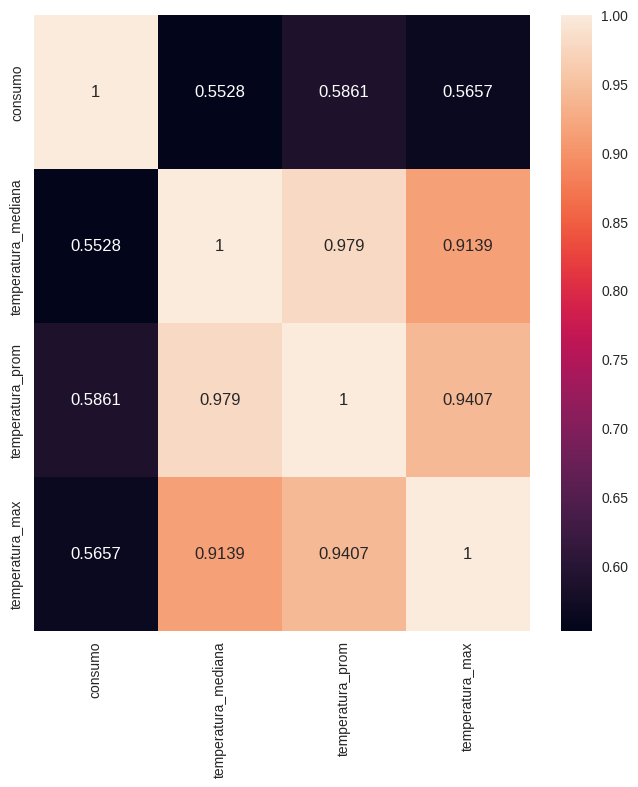

In [ ]:
spearman = np.asarray(spearman)
valor_p = np.asarray(valor_p)

spearman_r = spearman.reshape(data.shape[1],data.shape[1])
p_value = valor_p.reshape(data.shape[1],data.shape[1])

plt.figure(figsize=(8,8))
ax = sns.heatmap(np.around(spearman_r,4), annot=True, fmt='g', xticklabels = data_consumo_normalizada.columns, yticklabels = data_consumo_normalizada.columns)
plt.show()

### Analisis de datos por hora

In [ ]:
data_hora = data_consumo[['consumo', 'fecha_hora', 'hora', 'dia_semana', 'fin_de_semana', 'festivos', 'tipo_dia', 'tipo_semana',
                          'mes', 'temperatura_mediana', 'temperatura_prom', 'temperatura_max']].copy(deep=True)

data_hora = data_hora.set_index('fecha_hora').asfreq('h')

data_hora

,consumo,hora,dia_semana,fin_de_semana,festivos,tipo_dia,tipo_semana,mes,temperatura_mediana,temperatura_prom,temperatura_max
fecha_hora,,,,,,,,,,,
2015-01-01 00:00:00,874902,0,4,0,1,1,2,1,20.800,19.250000,21.3
2015-01-01 01:00:00,811130,1,4,0,1,1,2,1,20.700,18.900000,20.8
2015-01-01 02:00:00,768748,2,4,0,1,1,2,1,20.400,18.683333,20.5
2015-01-01 03:00:00,744469,3,4,0,1,1,2,1,20.200,18.566667,20.4
2015-01-01 04:00:00,735272,4,4,0,1,1,2,1,19.700,18.216667,19.9
...,...,...,...,...,...,...,...,...,...,...,...
2023-09-18 19:00:00,1651808,19,1,0,0,1,1,9,21.375,21.440000,25.7
2023-09-18 20:00:00,1590831,20,1,0,0,1,1,9,20.500,20.151667,24.3
2023-09-18 21:00:00,1465352,21,1,0,0,1,1,9,19.650,19.558750,23.3


#### Serie temporal

##### Visualización Visualización

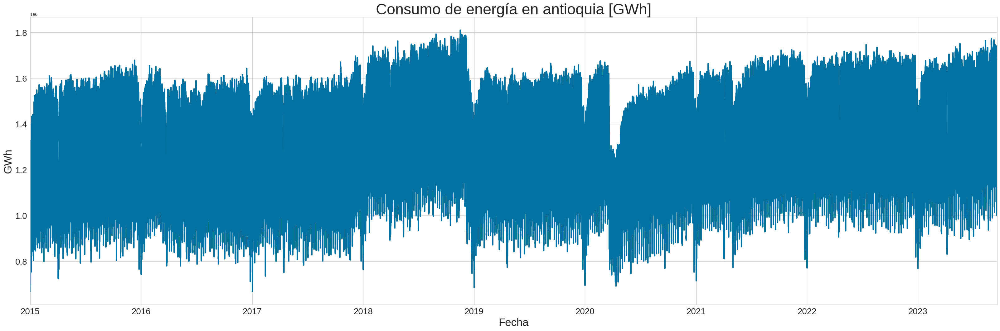

In [ ]:
# Visualización de la serie temporal
data_hora['consumo'].plot(figsize=(40, 12), linewidth=3)
plt.title('Consumo de energía en antioquia [GWh]', fontsize = 35)
plt.xlabel('Fecha', fontsize = 25)
plt.xticks(fontsize = 20)
plt.ylabel('GWh', fontsize = 25)
plt.yticks(fontsize = 20)
plt.show()

##### Descomposición estacional

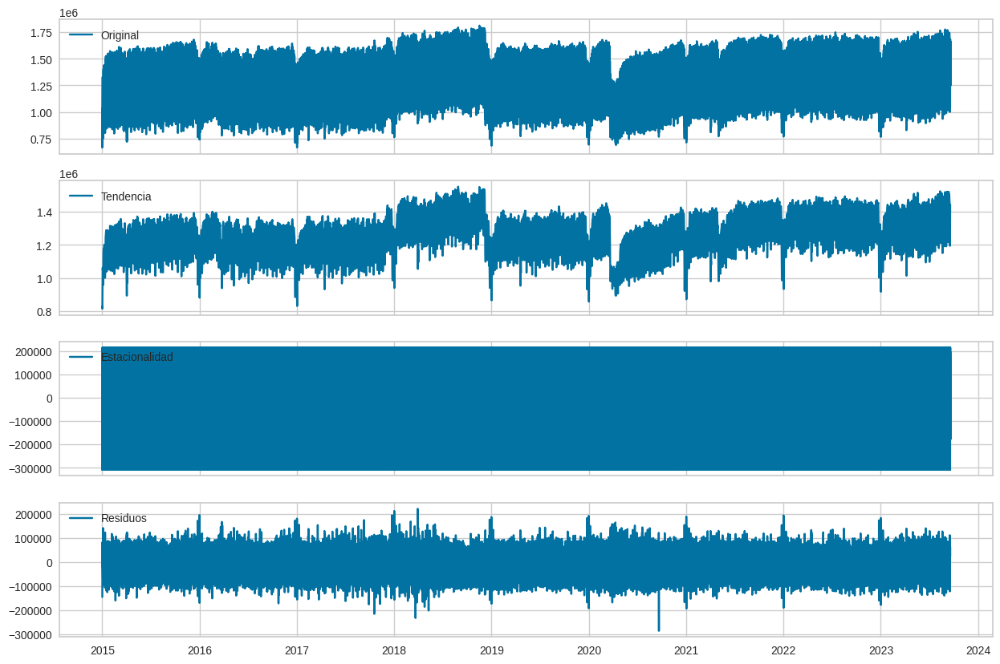

In [ ]:
# Identificación de tendencias
data_hora_descomposicion = sm.tsa.seasonal_decompose(data_hora['consumo'], model='additive')

data_hora_tendencia = data_hora_descomposicion.trend
data_hora_estacional = data_hora_descomposicion.seasonal
data_hora_residuo = data_hora_descomposicion.resid

fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_hora['consumo'], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_hora_tendencia, label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_hora_estacional, label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_hora_residuo,  label='Residuos')
axes[3].legend(loc='upper left');

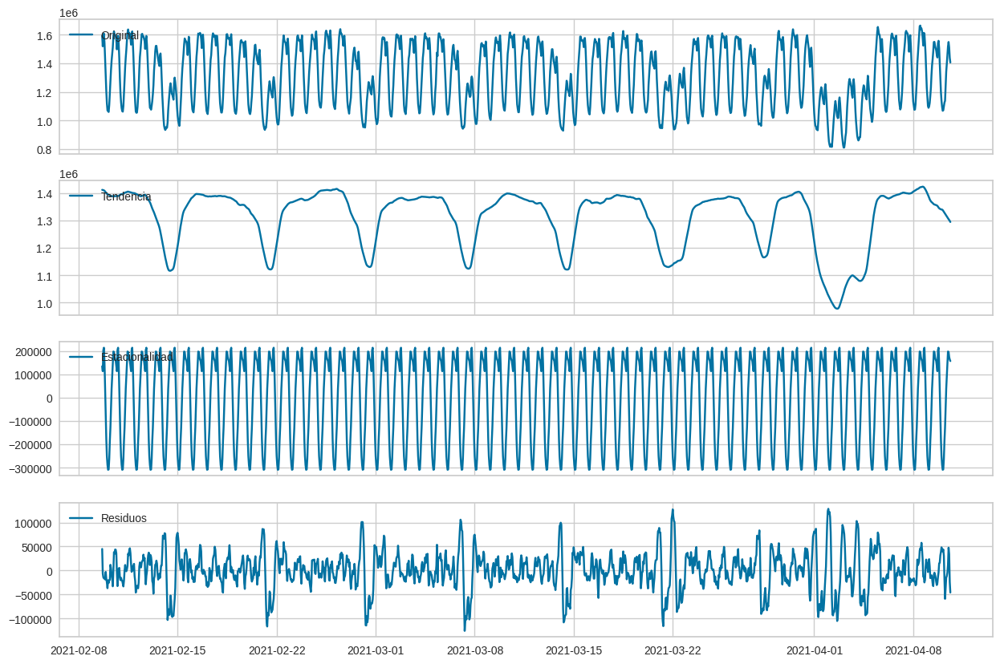

In [ ]:
# Identificación de tendencias para dos primeros meses del 2021
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_hora['consumo'][53560:55000], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_hora_tendencia[53560:55000], label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_hora_estacional[53560:55000], label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_hora_residuo[53560:55000], label='Residuos')
axes[3].legend(loc='upper left');

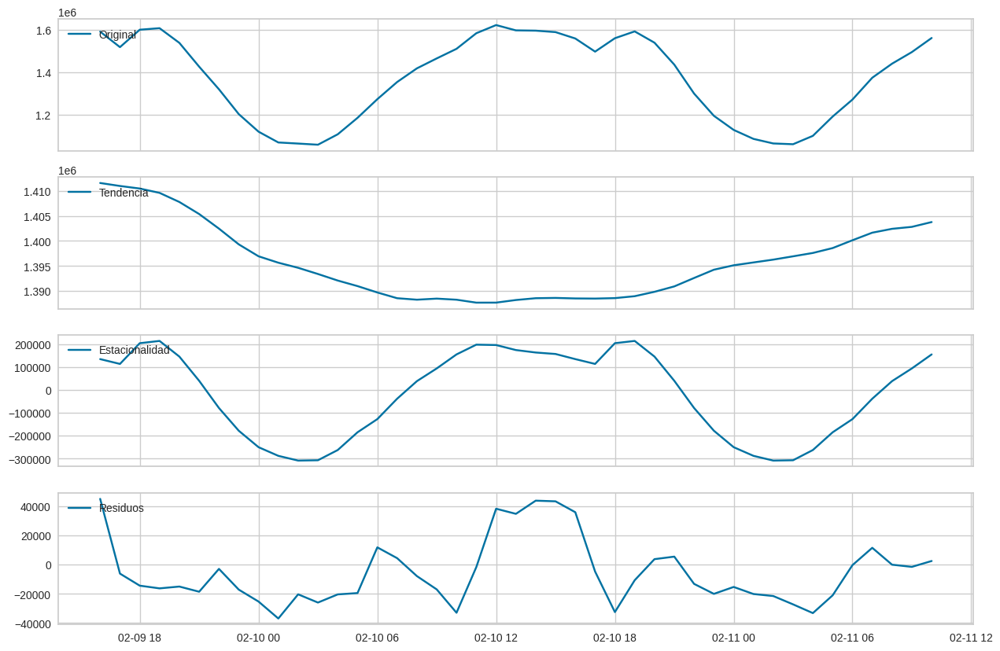

In [ ]:
# Identificación de tendencias en los primero 2 dias del 2021
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_hora['consumo'][53560:53603], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_hora_tendencia[53560:53603], label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_hora_estacional[53560:53603], label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_hora_residuo[53560:53603], label='Residuos')
axes[3].legend(loc='upper left');

##### Histograma del consumo

###### Todos los datos

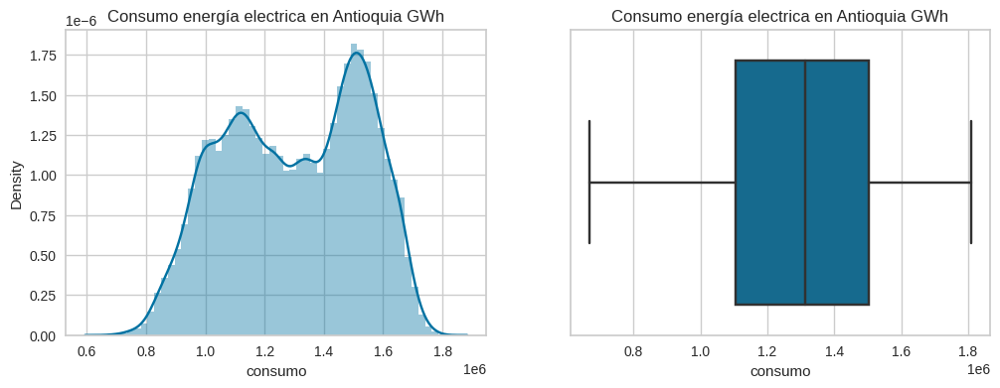

In [ ]:
#Histograma y boxplot del consumo de energía en antioquia
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.distplot(data_hora['consumo'])

plt.subplot(1,2,2)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.boxplot(x=data_hora['consumo'])

plt.show()

###### Filtrando por tipo de dia

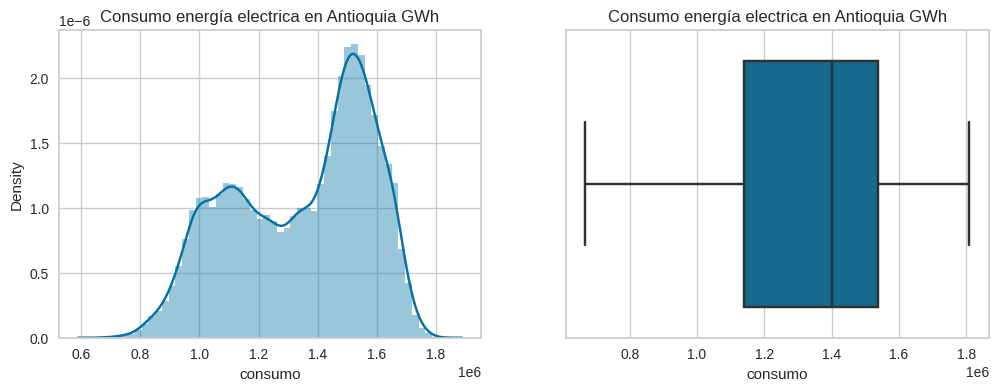

In [ ]:
#Histograma y boxplot del consumo de energía en antioquia por tipo de dia 1
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.distplot(data_hora[data_hora['tipo_dia'] == 1]['consumo'])

plt.subplot(1,2,2)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.boxplot(x=data_hora[data_hora['tipo_dia'] == 1]['consumo'])

plt.show()

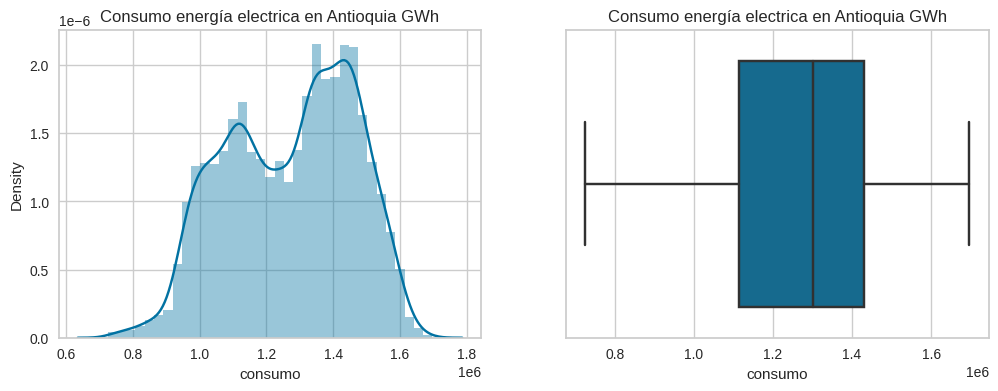

In [ ]:
#Histograma y boxplot del consumo de energía en antioquia por tipo de dia 2
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.distplot(data_hora[data_hora['tipo_dia'] == 2]['consumo'])

plt.subplot(1,2,2)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.boxplot(x=data_hora[data_hora['tipo_dia'] == 2]['consumo'])

plt.show()

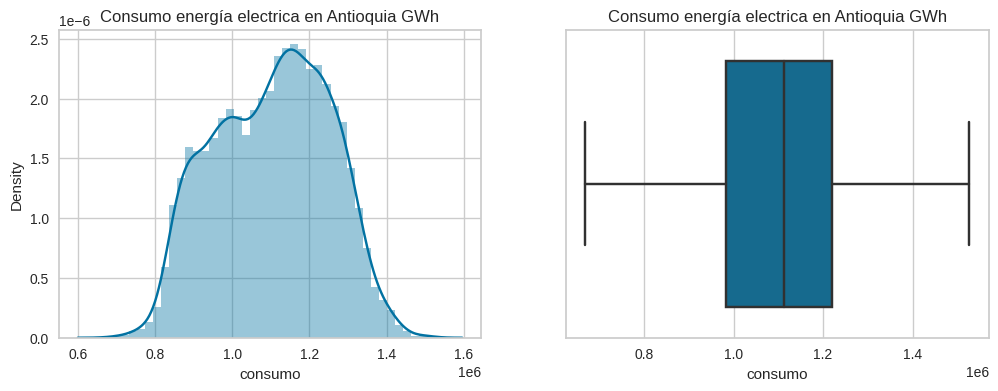

In [ ]:
#Histograma y boxplot del consumo de energía en antioquia por tipo de dia 3
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.distplot(data_hora[data_hora['tipo_dia'] == 3]['consumo'])

plt.subplot(1,2,2)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.boxplot(x=data_hora[data_hora['tipo_dia'] == 3]['consumo'])

plt.show()

###### Filtrando por tipo de semana

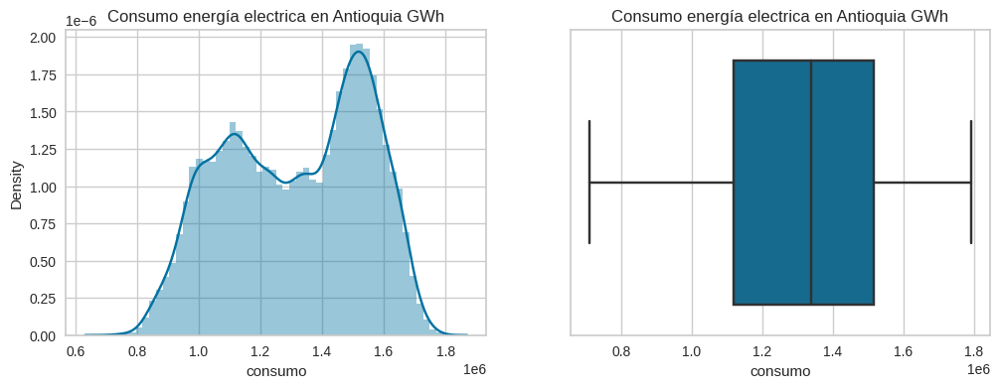

In [ ]:
#Histograma y boxplot del consumo de energía en antioquia por tipo de semana 1
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.distplot(data_hora[data_hora['tipo_semana'] == 1]['consumo'])

plt.subplot(1,2,2)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.boxplot(x=data_hora[data_hora['tipo_semana'] == 1]['consumo'])

plt.show()

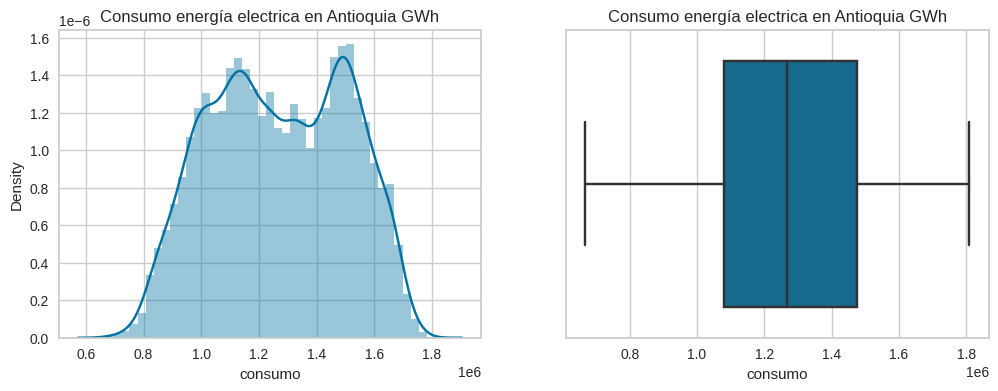

In [ ]:
#Histograma y boxplot del consumo de energía en antioquia por tipo de semana 2
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.distplot(data_hora[data_hora['tipo_semana'] == 2]['consumo'])

plt.subplot(1,2,2)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.boxplot(x=data_hora[data_hora['tipo_semana'] == 2]['consumo'])

plt.show()

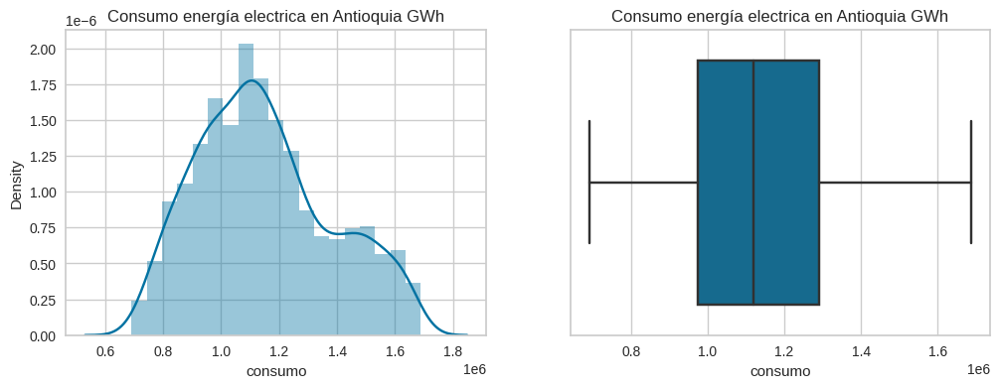

In [ ]:
#Histograma y boxplot del consumo de energía en antioquia por tipo de semana 3
plt.figure(figsize=(12,4))

plt.subplot(1,2,1)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.distplot(data_hora[data_hora['tipo_semana'] == 3]['consumo'])

plt.subplot(1,2,2)
plt.title('Consumo energía electrica en Antioquia GWh')
sns.boxplot(x=data_hora[data_hora['tipo_semana'] == 3]['consumo'])

plt.show()

##### Autocorrelación

###### Todos los datos

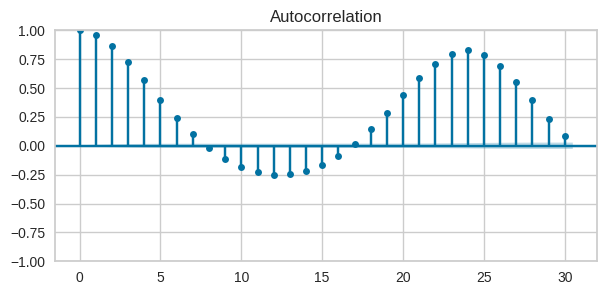

In [ ]:
# Gráfico autocorrelación
fig, ax = plt.subplots(figsize=(7, 3))
plot_acf(data_hora['consumo'], ax=ax, lags=30)
plt.show()

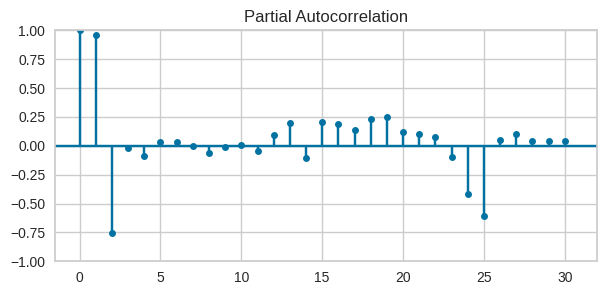

In [ ]:
# Gráfico autocorrelación parcial
fig, ax = plt.subplots(figsize=(7, 3))
plot_pacf(data_hora['consumo'], ax=ax, lags=30)
plt.show()

###### Filtrando por tipo de dia

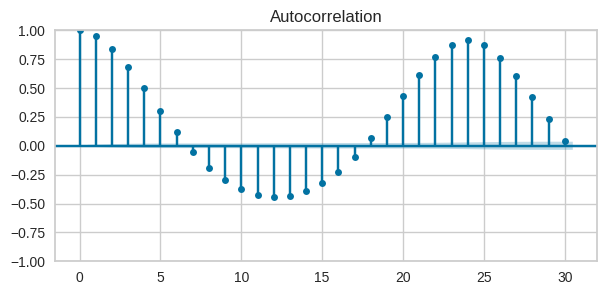

In [ ]:
# Gráfico autocorrelación por tipo de dia 1
fig, ax = plt.subplots(figsize=(7, 3))
plot_acf(data_hora[data_hora['tipo_dia'] == 1]['consumo'], ax=ax, lags=30)
plt.show()

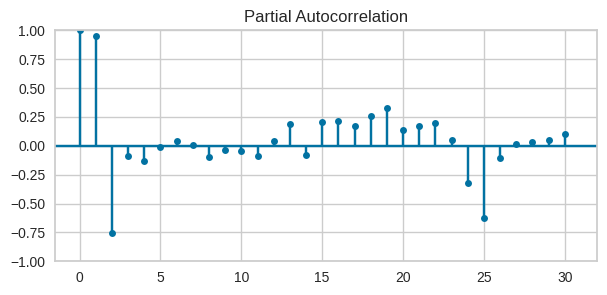

In [ ]:
# Gráfico autocorrelación parcial por tipo de dia 1
fig, ax = plt.subplots(figsize=(7, 3))
plot_pacf(data_hora[data_hora['tipo_dia'] == 1]['consumo'], ax=ax, lags=30)
plt.show()

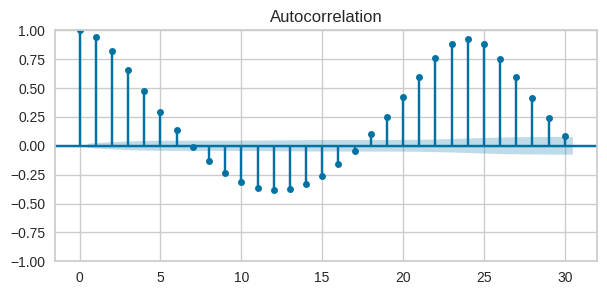

In [ ]:
# Gráfico autocorrelación por tipo de dia 2
fig, ax = plt.subplots(figsize=(7, 3))
plot_acf(data_hora[data_hora['tipo_dia'] == 2]['consumo'], ax=ax, lags=30)
plt.show()

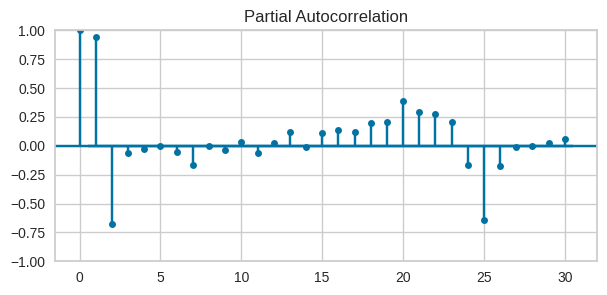

In [ ]:
# Gráfico autocorrelación parcial por tipo de dia 2
fig, ax = plt.subplots(figsize=(7, 3))
plot_pacf(data_hora[data_hora['tipo_dia'] == 2]['consumo'], ax=ax, lags=30)
plt.show()

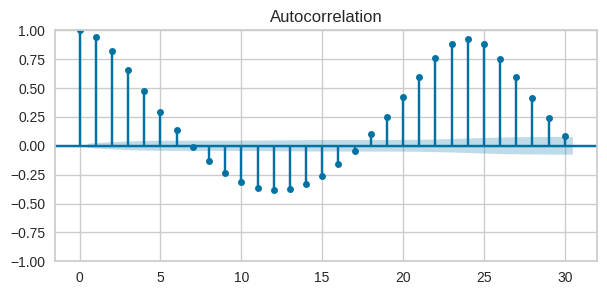

In [ ]:
# Gráfico autocorrelación por tipo de dia 3
fig, ax = plt.subplots(figsize=(7, 3))
plot_acf(data_hora[data_hora['tipo_dia'] == 2]['consumo'], ax=ax, lags=30)
plt.show()

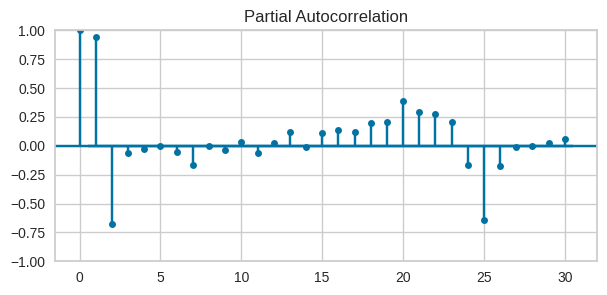

In [ ]:
# Gráfico autocorrelación parcial por tipo de dia 3
fig, ax = plt.subplots(figsize=(7, 3))
plot_pacf(data_hora[data_hora['tipo_dia'] == 2]['consumo'], ax=ax, lags=30)
plt.show()

###### Filtrando por tipo de semana

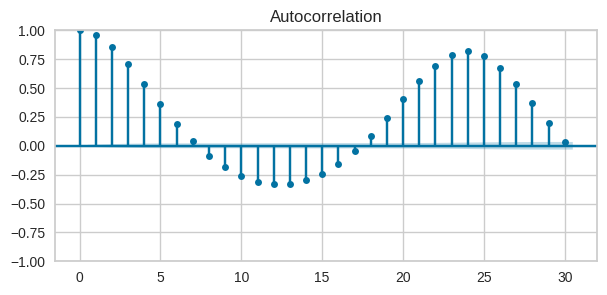

In [ ]:
# Gráfico autocorrelación por tipo de semana 1
fig, ax = plt.subplots(figsize=(7, 3))
plot_acf(data_hora[data_hora['tipo_semana'] == 1]['consumo'], ax=ax, lags=30)
plt.show()

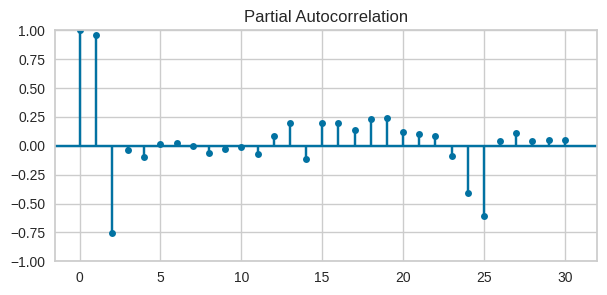

In [ ]:
# Gráfico autocorrelación parcial por tipo de semana 1
fig, ax = plt.subplots(figsize=(7, 3))
plot_pacf(data_hora[data_hora['tipo_semana'] == 1]['consumo'], ax=ax, lags=30)
plt.show()

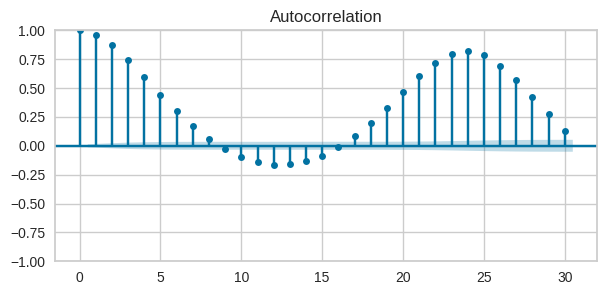

In [ ]:
# Gráfico autocorrelación por tipo de semana 2
fig, ax = plt.subplots(figsize=(7, 3))
plot_acf(data_hora[data_hora['tipo_semana'] == 2]['consumo'], ax=ax, lags=30)
plt.show()

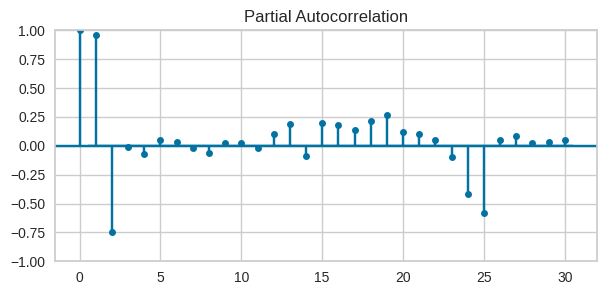

In [ ]:
# Gráfico autocorrelación parcial por tipo de semana 2
fig, ax = plt.subplots(figsize=(7, 3))
plot_pacf(data_hora[data_hora['tipo_semana'] == 2]['consumo'], ax=ax, lags=30)
plt.show()

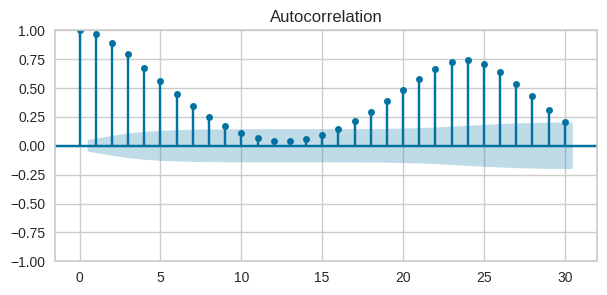

In [ ]:
# Gráfico autocorrelación por tipo de semana 3
fig, ax = plt.subplots(figsize=(7, 3))
plot_acf(data_hora[data_hora['tipo_semana'] == 3]['consumo'], ax=ax, lags=30)
plt.show()

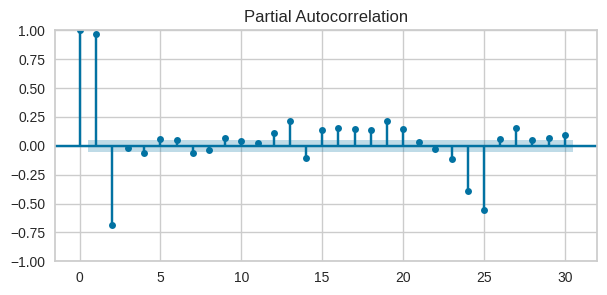

In [ ]:
# Gráfico autocorrelación parcial por tipo de semana 3
fig, ax = plt.subplots(figsize=(7, 3))
plot_pacf(data_hora[data_hora['tipo_semana'] == 3]['consumo'], ax=ax, lags=30)
plt.show()

##### Boxplot estacionalidad

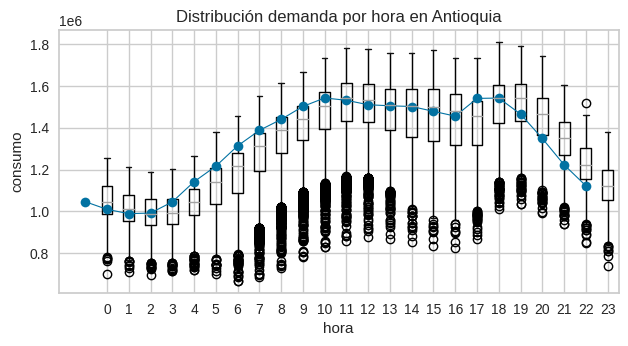

In [ ]:
# Boxplot para estacionalidad hora
fig, ax = plt.subplots(figsize=(7, 3.5))
data_hora.boxplot(column='consumo', by='hora', ax=ax)
data_hora.groupby('hora')['consumo'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('consumo')
ax.set_title('Distribución demanda por hora en Antioquia')
fig.suptitle('');

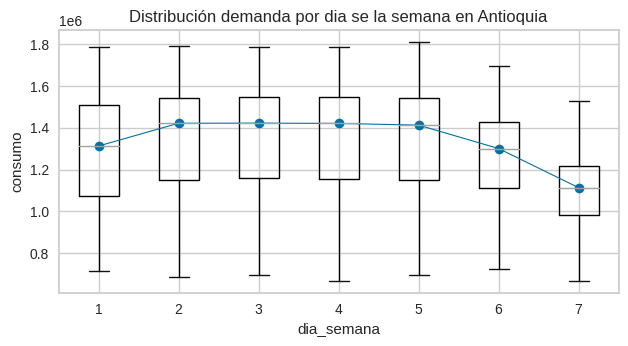

In [ ]:
# Boxplot para estacionalidad diaria
fig, ax = plt.subplots(figsize=(7, 3.5))
data_hora.boxplot(column='consumo', by='dia_semana', ax=ax)
data_hora.groupby('dia_semana')['consumo'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('consumo')
ax.set_title('Distribución demanda por dia se la semana en Antioquia')
fig.suptitle('');

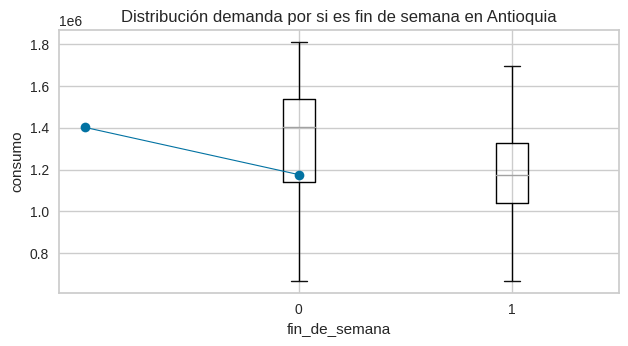

In [ ]:
# Boxplot para estacionalidad diaria
fig, ax = plt.subplots(figsize=(7, 3.5))
data_hora.boxplot(column='consumo', by='fin_de_semana', ax=ax)
data_hora.groupby('fin_de_semana')['consumo'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('consumo')
ax.set_title('Distribución demanda por si es fin de semana en Antioquia')
fig.suptitle('');

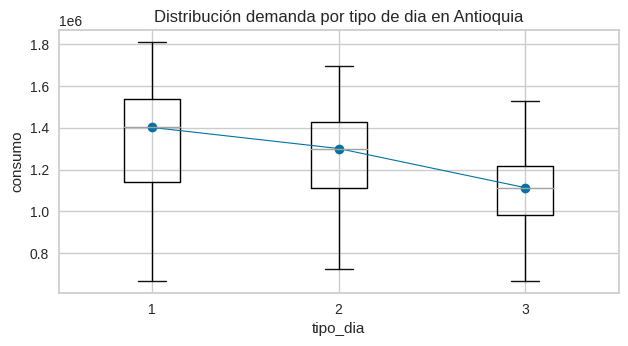

In [ ]:
# Boxplot para estacionalidad diaria
fig, ax = plt.subplots(figsize=(7, 3.5))
data_hora.boxplot(column='consumo', by='tipo_dia', ax=ax)
data_hora.groupby('tipo_dia')['consumo'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('consumo')
ax.set_title('Distribución demanda por tipo de dia en Antioquia')
fig.suptitle('');

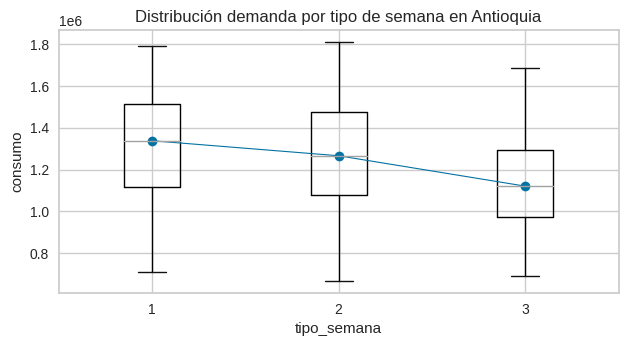

In [ ]:
# Boxplot para estacionalidad semanal
fig, ax = plt.subplots(figsize=(7, 3.5))
data_hora.boxplot(column='consumo', by='tipo_semana', ax=ax)
data_hora.groupby('tipo_semana')['consumo'].median().plot(style='o-', linewidth=0.8, ax=ax)
ax.set_ylabel('consumo')
ax.set_title('Distribución demanda por tipo de semana en Antioquia')
fig.suptitle('');

#### Serie temporal de las diferencias

##### Visualización Visualización

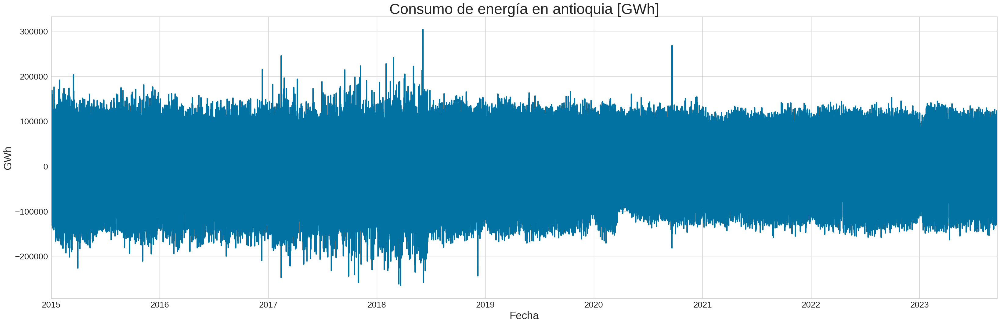

In [ ]:
# Visualización de la serie temporal
data_hora['consumo'].diff().plot(figsize=(40, 12), linewidth=3)
plt.title('Consumo de energía en antioquia [GWh]', fontsize = 35)
plt.xlabel('Fecha', fontsize = 25)
plt.xticks(fontsize = 20)
plt.ylabel('GWh', fontsize = 25)
plt.yticks(fontsize = 20)
plt.show()

##### Descomposición estacional

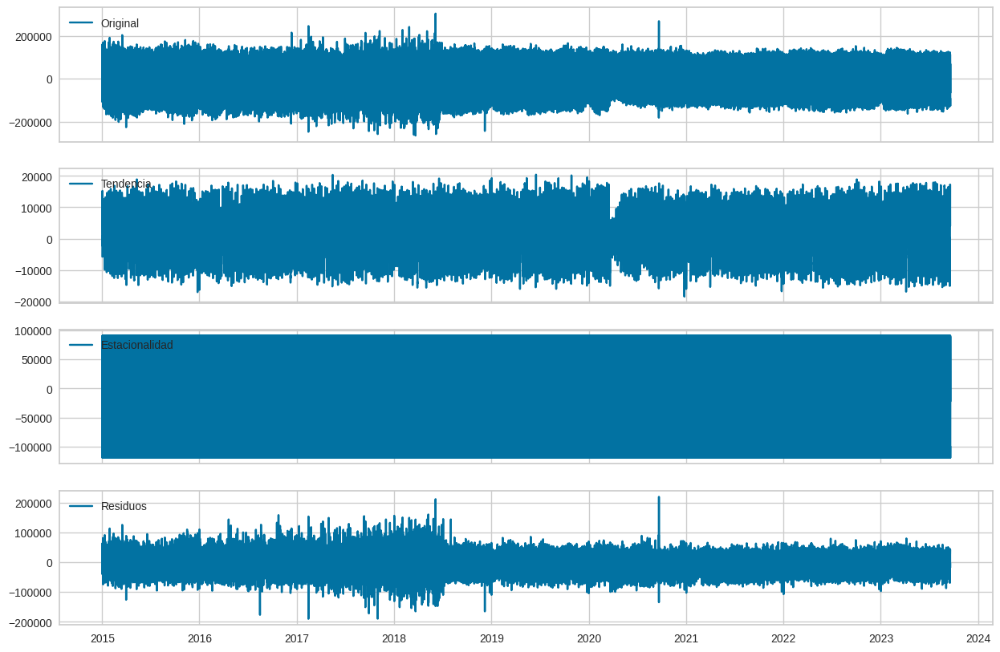

In [ ]:
# Identificación de tendencias
data_hora_descomposicion = sm.tsa.seasonal_decompose(data_hora['consumo'].diff().dropna(), model='additive')

data_hora_tendencia = data_hora_descomposicion.trend
data_hora_estacional = data_hora_descomposicion.seasonal
data_hora_residuo = data_hora_descomposicion.resid

fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_hora['consumo'].diff().dropna(), label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_hora_tendencia, label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_hora_estacional, label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_hora_residuo,  label='Residuos')
axes[3].legend(loc='upper left');

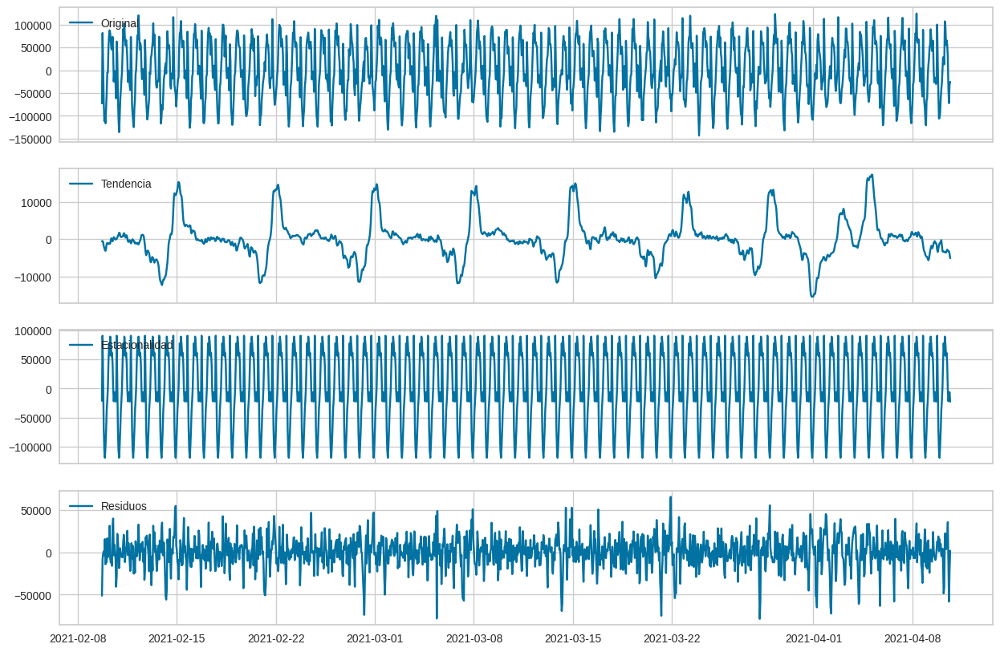

In [ ]:
# Identificación de tendencias para dos primeros meses del 2021
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_hora['consumo'].diff().dropna()[53560:55000], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_hora_tendencia[53560:55000], label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_hora_estacional[53560:55000], label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_hora_residuo[53560:55000], label='Residuos')
axes[3].legend(loc='upper left');

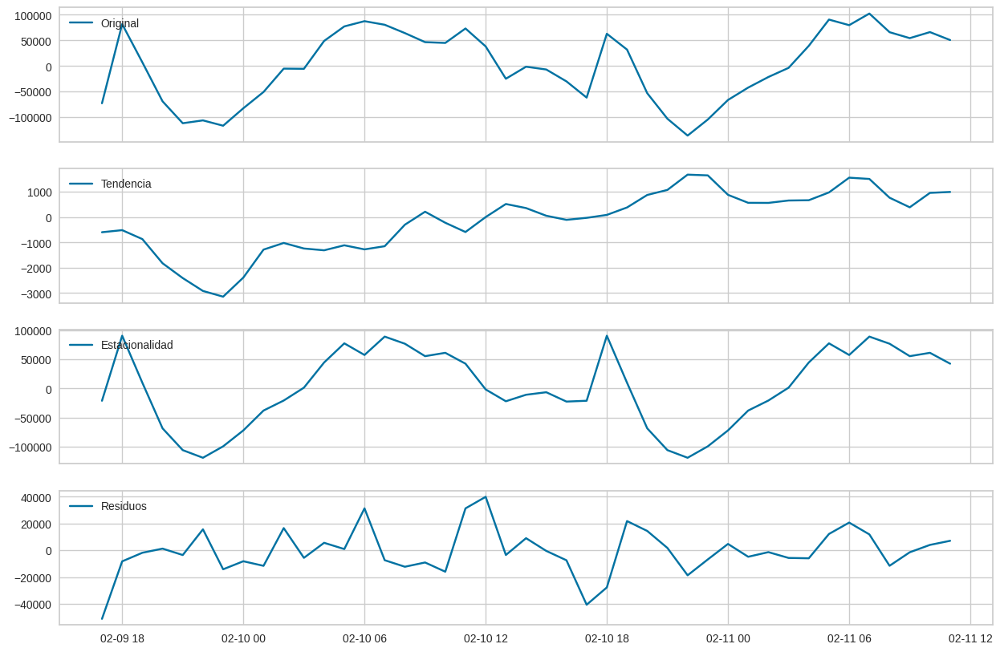

In [ ]:
# Identificación de tendencias en los primero 2 dias del 2021
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_hora['consumo'].diff().dropna()[53560:53603], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_hora_tendencia[53560:53603], label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_hora_estacional[53560:53603], label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_hora_residuo[53560:53603], label='Residuos')
axes[3].legend(loc='upper left');

#### Cluster normales

##### Graficos de dispersion

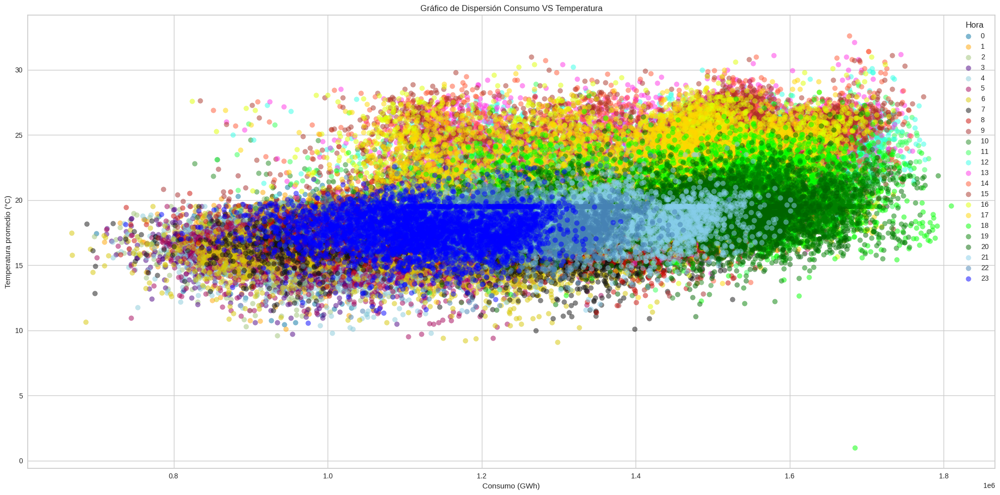

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k', 'r', 'Brown', 'ForestGreen',
        '#33FF57', '#33FFE6', '#FF33E6', '#FF5733', '#A93226', '#DFFF00', '#FFD700', '#00FF00', '#008000', '#006400', '#87CEEB', '#4682B4',
          '#0000FF', '#000080']

etiquetas = data_consumo['hora'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo[data_consumo['hora'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Hora')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

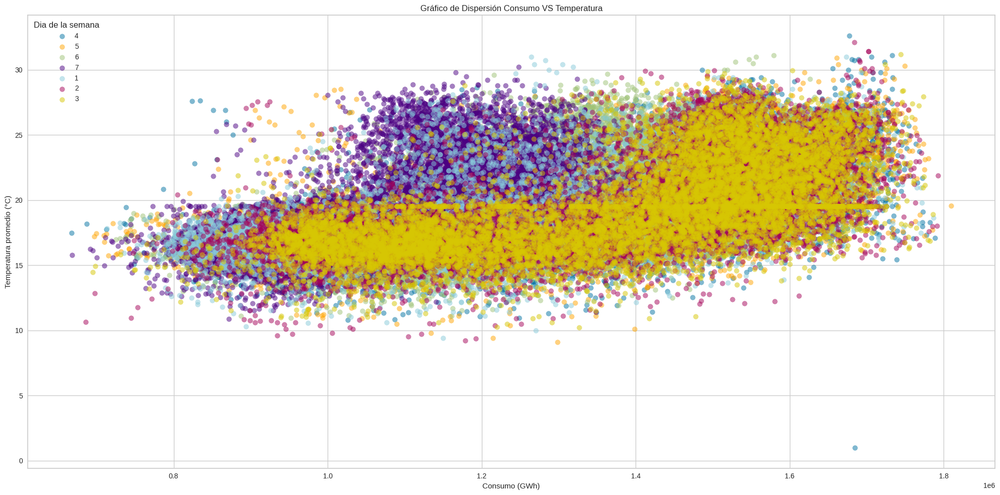

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k']

etiquetas = data_consumo['dia_semana'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo[data_consumo['dia_semana'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Dia de la semana')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

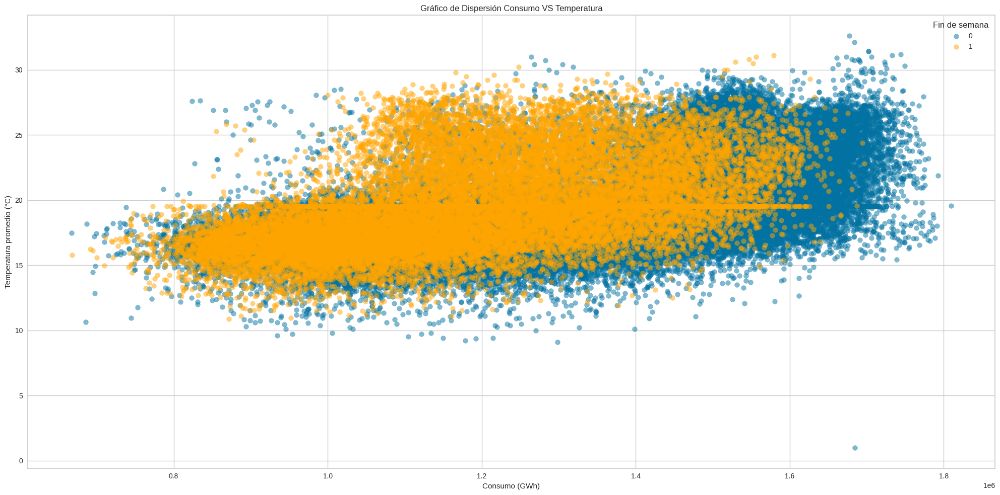

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k']

etiquetas = data_consumo['fin_de_semana'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo[data_consumo['fin_de_semana'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Fin de semana')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

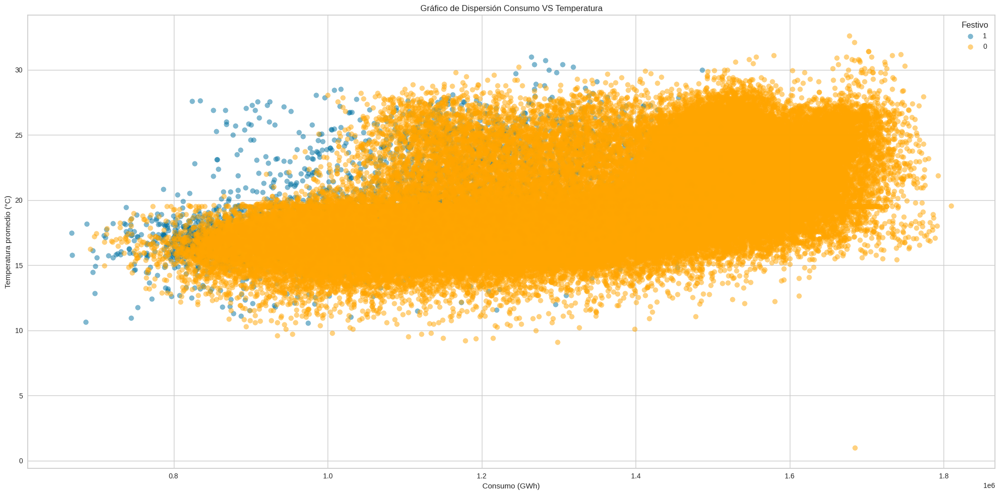

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k']

etiquetas = data_consumo['festivos'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo[data_consumo['festivos'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Festivo')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

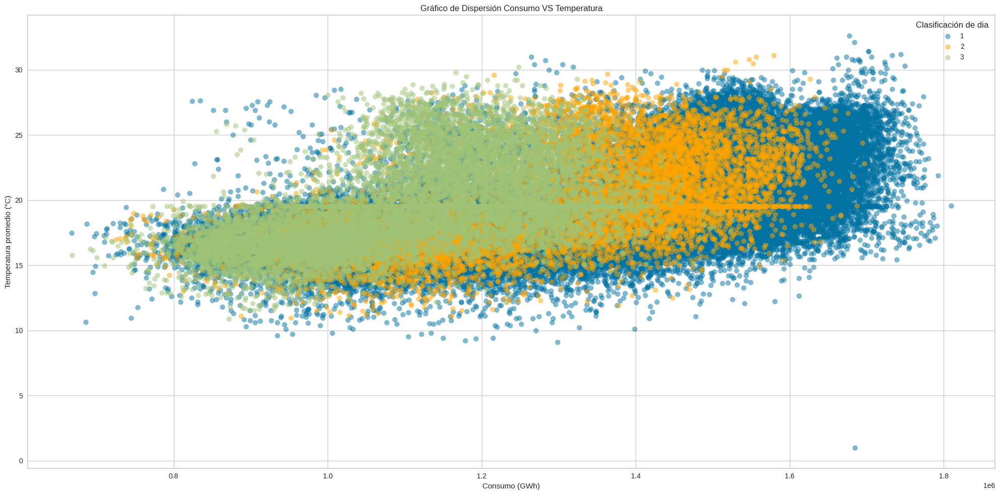

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k']

etiquetas = data_consumo['tipo_dia'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo[data_consumo['tipo_dia'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Clasificación de dia')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

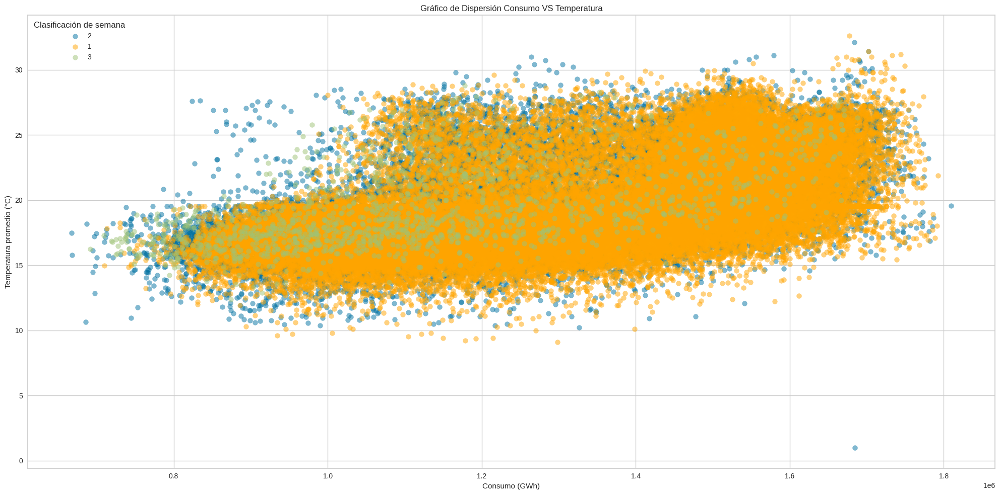

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k']

etiquetas = data_consumo['tipo_semana'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo[data_consumo['tipo_semana'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Clasificación de semana')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Crear el gráfico de dispersión 3D interactivo con Plotly
fig = px.scatter_3d(data_consumo, x='consumo', y='temperatura_prom', z='dia_semana', color='tipo_dia', symbol='tipo_dia', opacity=0.5)

# Personalizar el gráfico
fig.update_layout(
    title='Gráfico de Dispersión Consumo VS Temperatura VS Horas',
    scene=dict(
        xaxis_title='Consumo (GWh)',
        yaxis_title='Temperatura promedio (°C)',
        zaxis_title='Dia de la semama'
    )
)

# Mostrar el gráfico interactivo en Colab
fig.show()

In [ ]:
# Crear el gráfico de dispersión 3D interactivo con Plotly
fig = px.scatter_3d(data_consumo, x='consumo', y='temperatura_prom', z='dia_semana', color='tipo_semana', opacity=0.5)

# Personalizar el gráfico
fig.update_layout(
    title='Gráfico de Dispersión Consumo VS Temperatura VS Horas',
    scene=dict(
        xaxis_title='Consumo (GWh)',
        yaxis_title='Temperatura promedio (°C)',
        zaxis_title='Dia de la semama'
    )
)

# Mostrar el gráfico interactivo en Colab
fig.show()

In [ ]:
# Escalar datos
X = data_consumo[['consumo', 'temperatura_mediana',	'temperatura_prom',	'temperatura_max']]

MM = MinMaxScaler(feature_range = (0,1))
X_norm_array = MM.fit_transform(X)
X_norm = pd.DataFrame(X_norm_array, columns = ['consumo','temperatura_mediana', 'temperatura_prom', 'temperatura_max'])

##### Encontrar cluster optimo

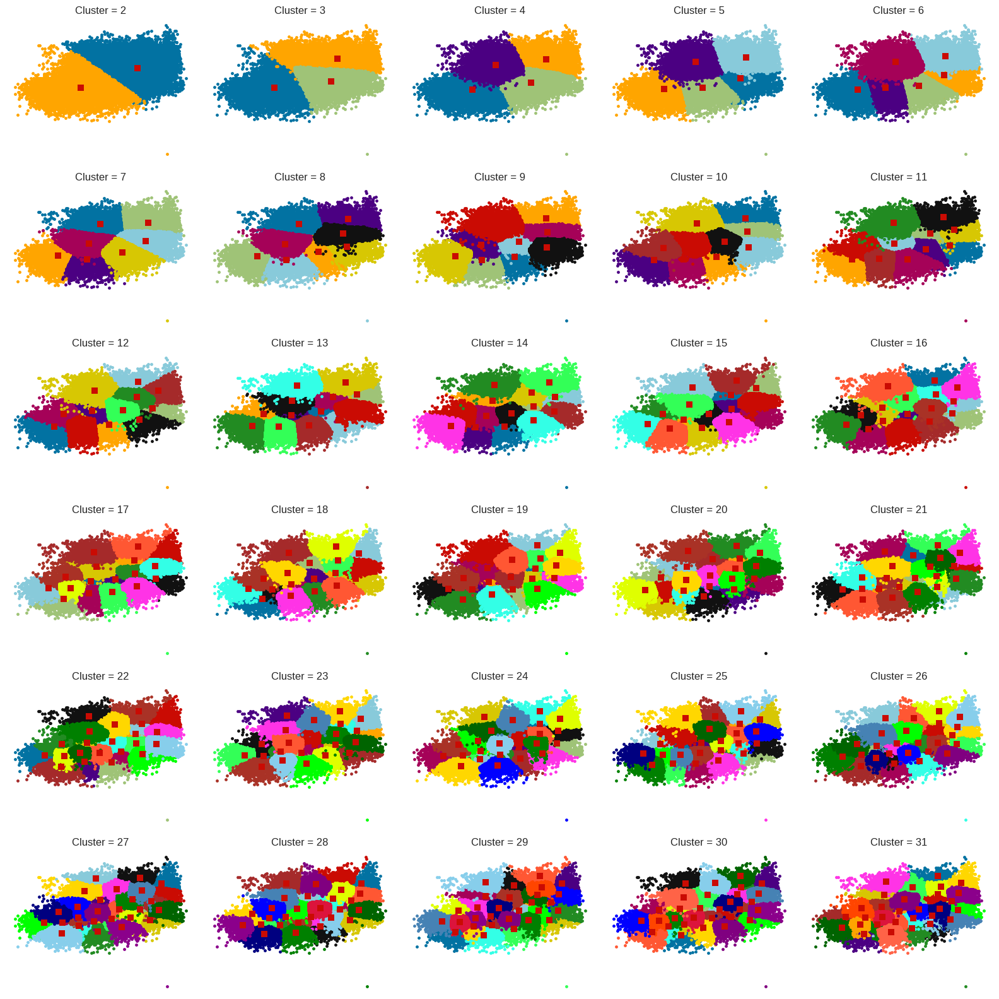

In [ ]:
x1 = X_norm['consumo']
x2 = X_norm['temperatura_prom']
feature_A = 0
feature_B = 1

fig1,axes1 = plt.subplots(6,5,figsize = (16,16))
error = 1e-4
max_iteraciones = 5000
colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k', 'r', 'Brown', 'ForestGreen',
        '#33FF57', '#33FFE6', '#FF33E6', '#FF5733', '#A93226', '#DFFF00', '#FFD700', '#00FF00', '#008000', '#006400', '#87CEEB', '#4682B4',
          '#0000FF', '#000080', '#800080', '#8B008B', '#DC143C', '#FF4500', '#FF6347', '#FFA500', '#FF8C00']

modelos = []
vector_clases = []
matriz_centros = []

silueta = []
calinski_harabasz = []
davies_bouldin = []

for ncenters, ax in enumerate(axes1.reshape(-1), 2):
  modelo_kmeans = KMeans(n_clusters = ncenters, max_iter = max_iteraciones, tol = error, random_state = 17)
  modelo_kmeans.fit(X_norm)
  clases = modelo_kmeans.labels_
  centros = modelo_kmeans.cluster_centers_
  modelos.append(modelo_kmeans)
  vector_clases.append(clases)
  matriz_centros.append(centros)

  silueta.append(silhouette_score(X_norm, clases))
  calinski_harabasz.append(calinski_harabasz_score(X_norm, clases))
  davies_bouldin.append(davies_bouldin_score(X_norm, clases))

  for j in range(ncenters):
    ax.plot(x1[clases == j], x2[clases == j], '.', color = colors[j])

  for pt in centros:
    ax.plot(pt[feature_A],pt[feature_B],'rs')

  ax.set_title('Cluster = {0}'.format(ncenters))
  ax.axis('off')

fig1.tight_layout()
plt.show()

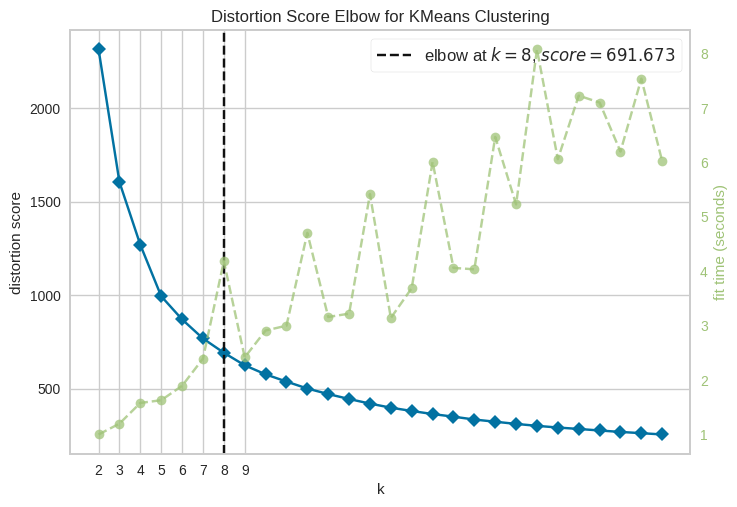

In [ ]:
fig, ax = plt.subplots()
elbow_graph = KElbowVisualizer(KMeans(max_iter = max_iteraciones, tol = error, random_state = 17),
                              k = (2, 30), ax = ax)
elbow_graph.fit(X_norm)
ax.set_xticks(range(2,10))
elbow_graph.show()
plt.show()

In [ ]:
# Define a range of K values
k_values = range(2, 30)
error = 1e-4
max_iteraciones = 5000

# Initialize lists to store silhouette scores for k-means and k-medoids
silhouette = []
calinski_harabasz = []
davies_bouldin = []

# Iterate through different K values
for k in k_values:
    # Initialize and fit KMeans
    kmeans = KMeans(n_clusters=k, max_iter = max_iteraciones, tol = error, random_state = 17)
    kmeans.fit(X_norm)

    clases = kmeans.labels_

    # Calculate silhouette scores for k-means and k-medoids
    silhouette.append(silhouette_score(X_norm, clases))
    calinski_harabasz.append(calinski_harabasz_score(X_norm, clases))
    davies_bouldin.append(davies_bouldin_score(X_norm, clases))


Text(0, 0.5, 'Silhouette Score')

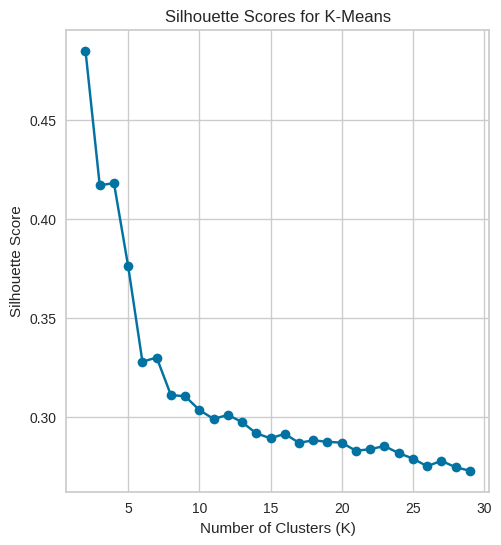

In [ ]:
# Plot silhouette scores for k-means
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(k_values, silhouette, marker='o', linestyle='-')
plt.title('Silhouette Scores for K-Means')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Silhouette Score')

Text(0, 0.5, 'Calinki Harabasz Score')

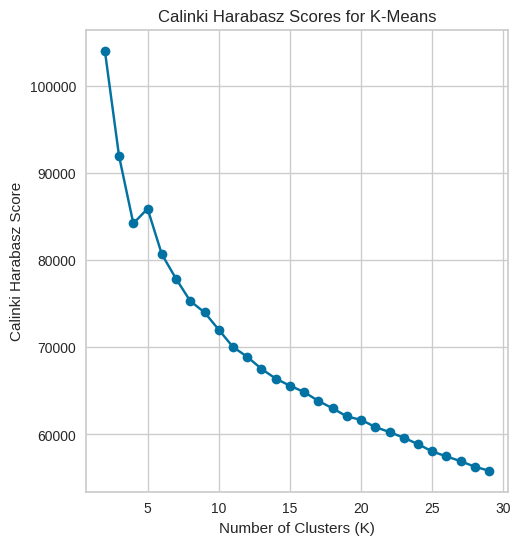

In [ ]:
# Plot Calinki Harabasz scores for k-means
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(k_values, calinski_harabasz, marker='o', linestyle='-')
plt.title('Calinki Harabasz Scores for K-Means')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Calinki Harabasz Score')

Text(0, 0.5, 'Davies Bouldin Score')

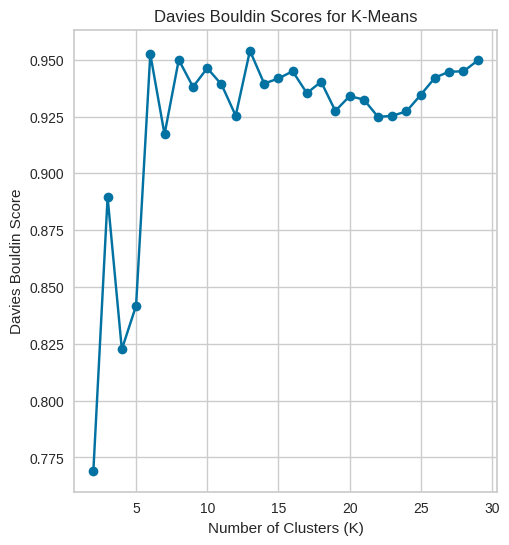

In [ ]:
# Plot Davies Bouldin scores for k-means
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(k_values, davies_bouldin, marker='o', linestyle='-')
plt.title('Davies Bouldin Scores for K-Means')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Davies Bouldin Score')

##### Graficos de cluster

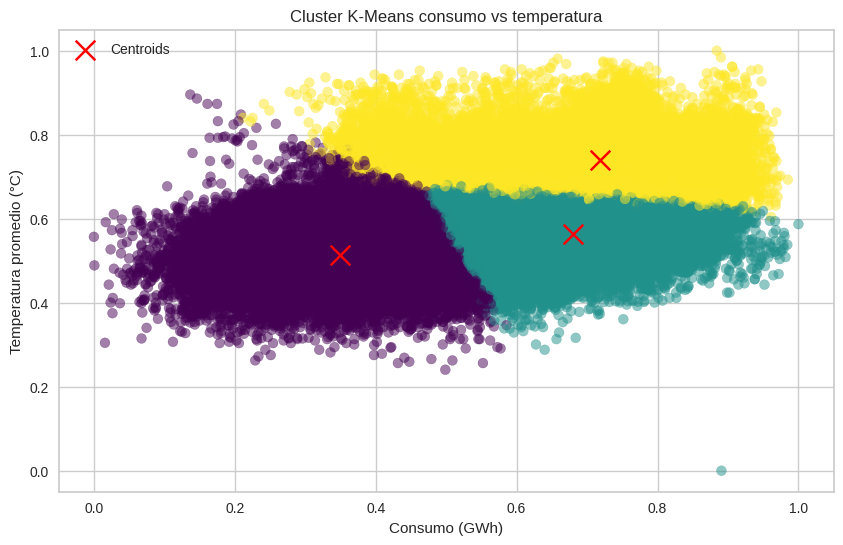

In [ ]:
# Aplica K-Means
n_clusters = 3  # Número de clústeres
kmeans = KMeans(n_clusters=n_clusters)
kmeans_labels = kmeans.fit_predict(X_norm_array)

# Obtiene los centroides de los clústeres
cluster_centers = kmeans.cluster_centers_

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=kmeans_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster K-Means consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

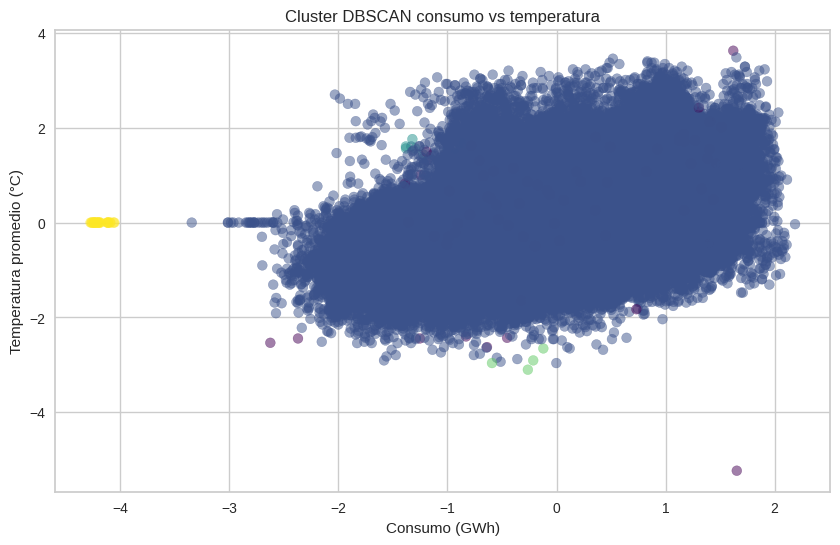

In [ ]:
# Aplica DBSCAN
dbscan = DBSCAN(eps=0.5, min_samples=5)
dbscan_labels = dbscan.fit_predict(X_norm_array)

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=dbscan_labels, cmap='viridis', s=50, alpha=0.5)
plt.title('Cluster DBSCAN consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.show()

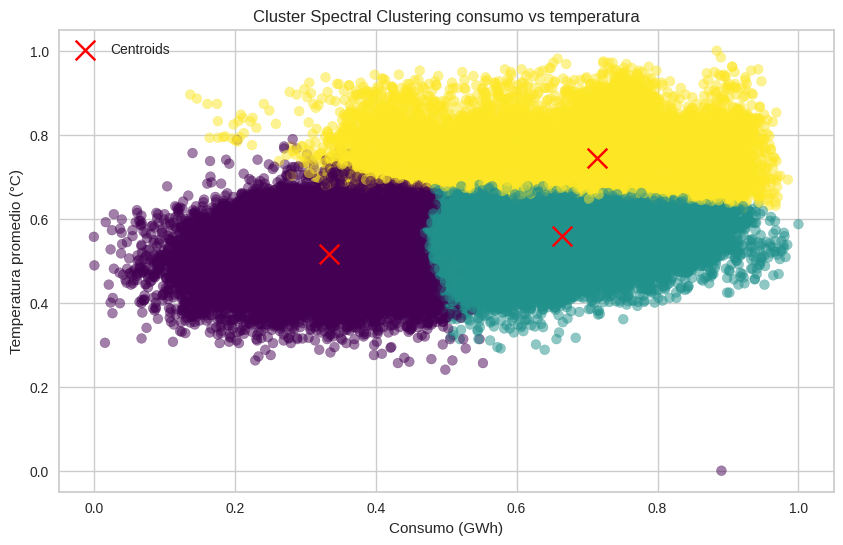

In [ ]:
# Aplica Spectral Clustering
n_clusters = 3  # Número de clústeres
spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', assign_labels='kmeans')
spectral_labels = spectral.fit_predict(X_norm_array)

# Calcula los centros de los clústeres
cluster_centers = []
for cluster in range(n_clusters):
    cluster_mask = spectral_labels == cluster
    cluster_center = np.mean(X_norm_array[cluster_mask], axis=0)
    cluster_centers.append(cluster_center)

cluster_centers = np.array(cluster_centers)

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=spectral_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster Spectral Clustering consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

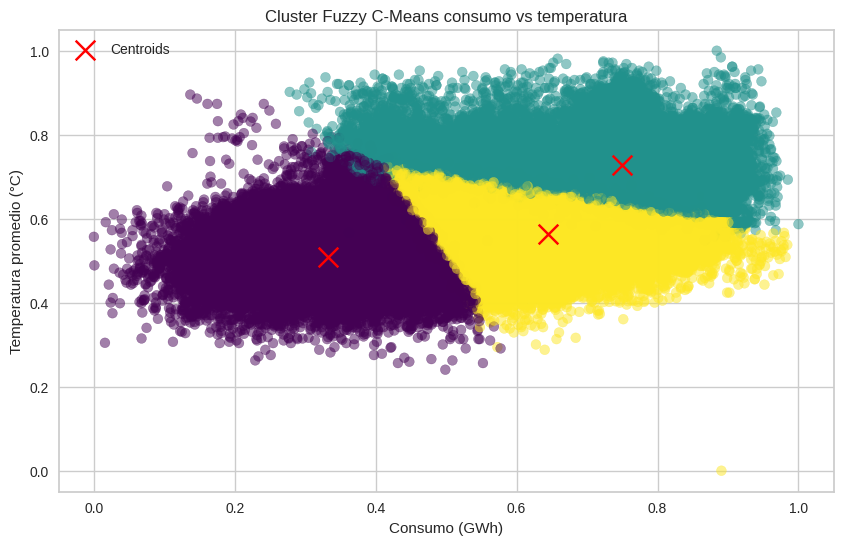

In [ ]:
# Aplica Fuzzy C-Means
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
    X_norm_array.T, n_clusters, m=2, error=0.005, maxiter=1000, init=None)

# Asigna cada punto a un clúster
cluster_membership = np.argmax(u, axis=0)

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=cluster_membership, cmap='viridis', s=50, alpha=0.5)
plt.scatter(cntr[:, 0], cntr[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.legend()
plt.title('Cluster Fuzzy C-Means consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.show()


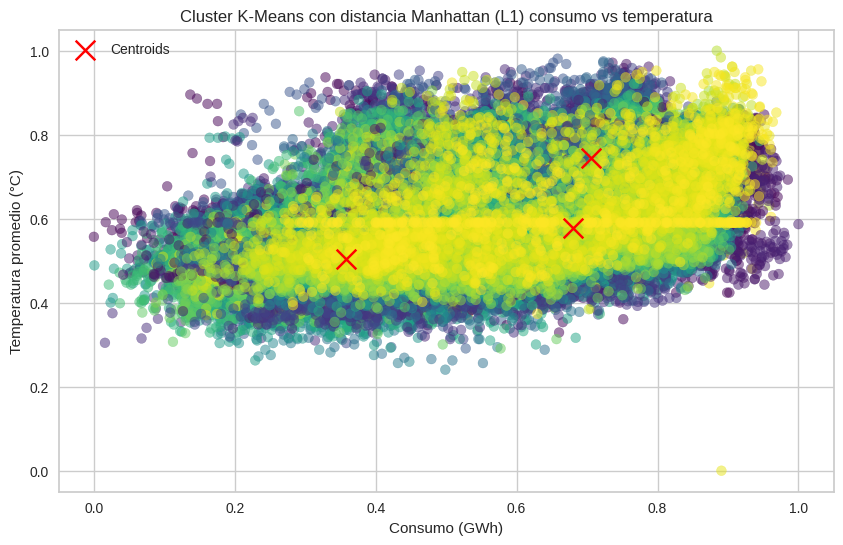

In [ ]:
# Define una métrica de distancia de Manhattan (L1)
manhattan_metric = distance_metric(type_metric.MANHATTAN)

# Inicializa K-Means
n_clusters = 3  # Número de clústeres
initial_centers = kmeans_plusplus_initializer(X_norm_array, n_clusters).initialize()
kmeans_instance = kmeans_(X_norm_array, initial_centers, metric=manhattan_metric)

# Ejecuta K-Means
kmeans_instance.process()
kmeans_labels = kmeans_instance.get_clusters()

# Obtiene los centroides de los clústeres
cluster_centers = np.array(kmeans_instance.get_centers())

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=np.hstack(kmeans_labels), cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster K-Means con distancia Manhattan (L1) consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

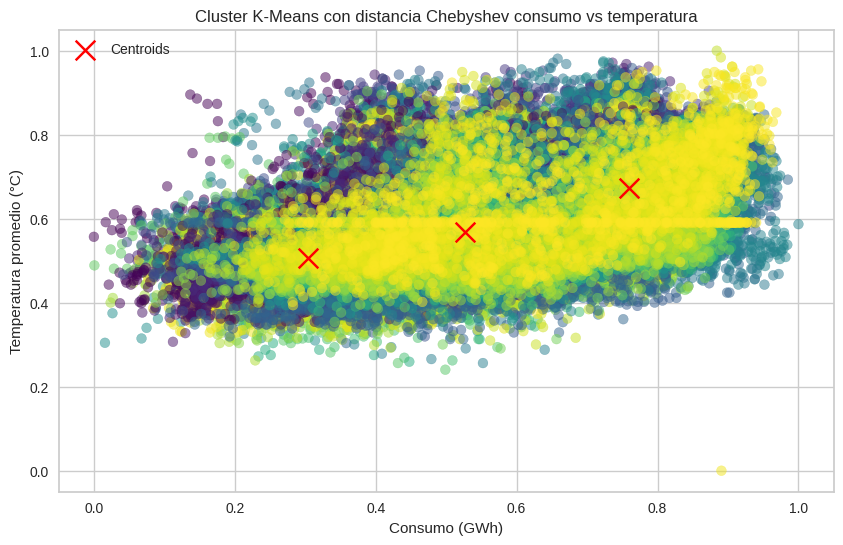

In [ ]:
# Define una función de distancia de Chebyshev (máxima diferencia en cada dimensión)
def chebyshev_distance(point1, point2):
    return max(abs(point1[i] - point2[i]) for i in range(len(point1)))

# Convierte la función de distancia personalizada en un tipo_metric
chebyshev_metric = distance_metric(type_metric.USER_DEFINED, func=chebyshev_distance)

# Inicializa K-Means
n_clusters = 3  # Número de clústeres
initial_centers = kmeans_plusplus_initializer(X_norm_array, n_clusters).initialize()
kmeans_instance = kmeans_(X_norm_array, initial_centers, metric=chebyshev_metric)

# Ejecuta K-Means
kmeans_instance.process()
kmeans_labels = kmeans_instance.get_clusters()

# Obtiene los centroides de los clústeres
cluster_centers = np.array(kmeans_instance.get_centers())

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=np.hstack(kmeans_labels), cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster K-Means con distancia Chebyshev consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

#### Cluster normales sin horas nocturnas

In [ ]:
data_consumo_simplificado = data_consumo[data_consumo['hora'].isin(list(range(6, 21)))]

In [1]:
# Escalar datos
X = data_consumo_simplificado[['consumo', 'temperatura_mediana',	'temperatura_prom',	'temperatura_max']]

MM = MinMaxScaler(feature_range = (0,1))
X_norm_array = MM.fit_transform(X)
X_norm = pd.DataFrame(X_norm_array, columns = ['consumo','temperatura_mediana', 'temperatura_prom', 'temperatura_max'])

NameError: ignored

##### Gráficos de dispersión

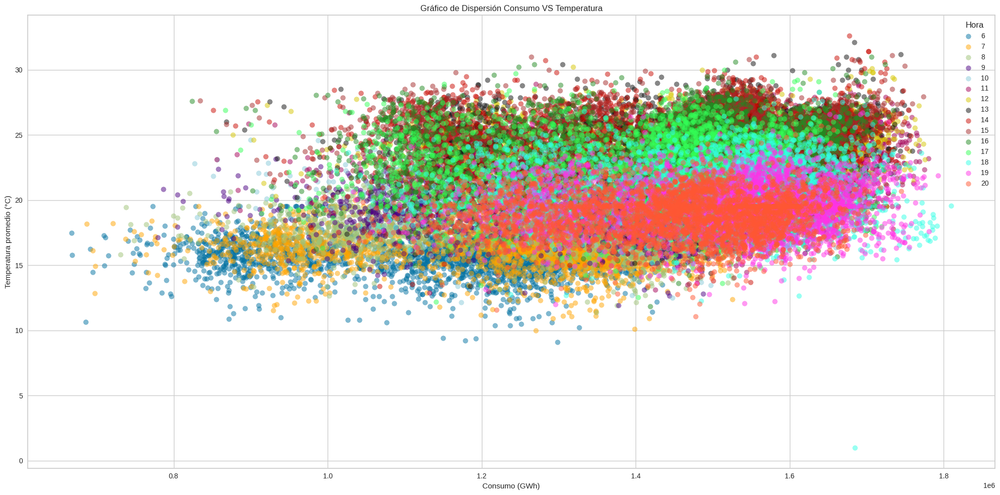

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k', 'r', 'Brown', 'ForestGreen',
        '#33FF57', '#33FFE6', '#FF33E6', '#FF5733', '#A93226', '#DFFF00', '#FFD700', '#00FF00', '#008000', '#006400', '#87CEEB', '#4682B4',
          '#0000FF', '#000080']

etiquetas = data_consumo_simplificado['hora'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo_simplificado[data_consumo_simplificado['hora'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Hora')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

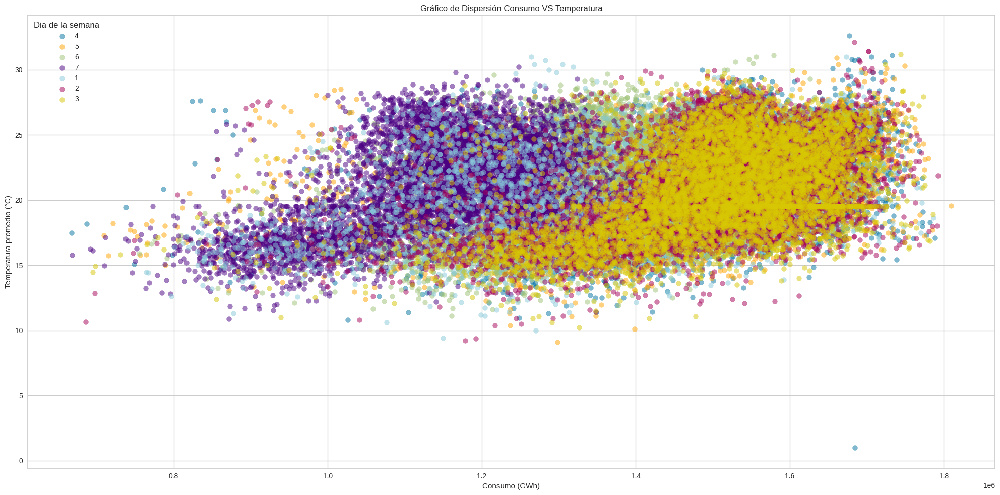

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k']

etiquetas = data_consumo_simplificado['dia_semana'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo_simplificado[data_consumo_simplificado['dia_semana'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Dia de la semana')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

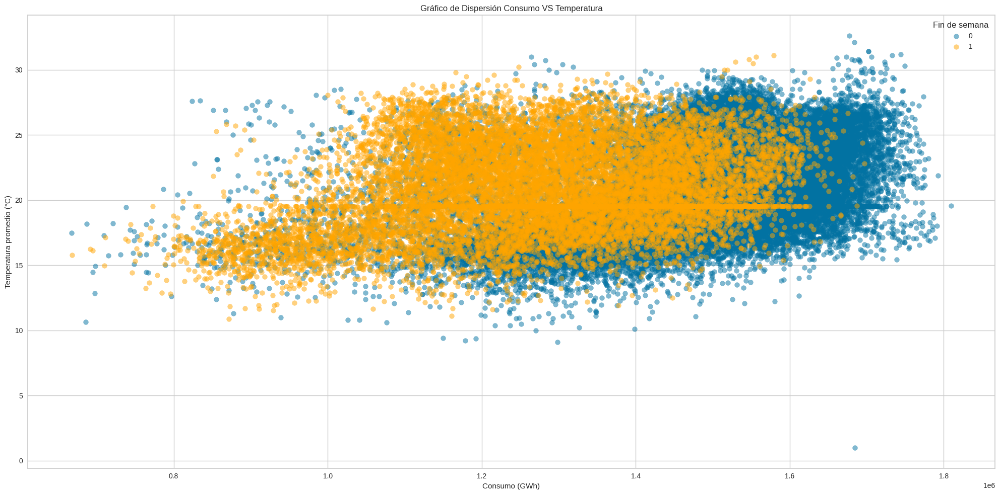

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k']

etiquetas = data_consumo_simplificado['fin_de_semana'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo_simplificado[data_consumo_simplificado['fin_de_semana'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Fin de semana')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

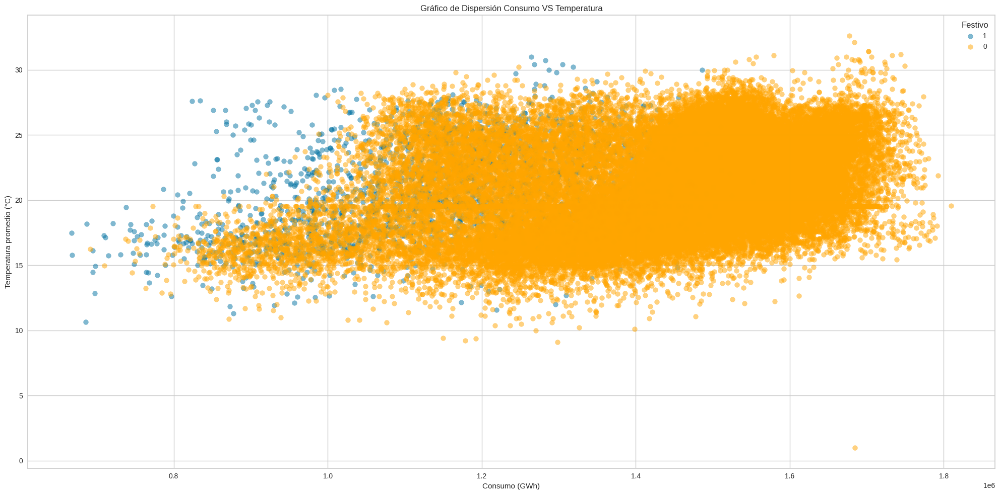

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k']

etiquetas = data_consumo_simplificado['festivos'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo_simplificado[data_consumo_simplificado['festivos'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Festivo')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

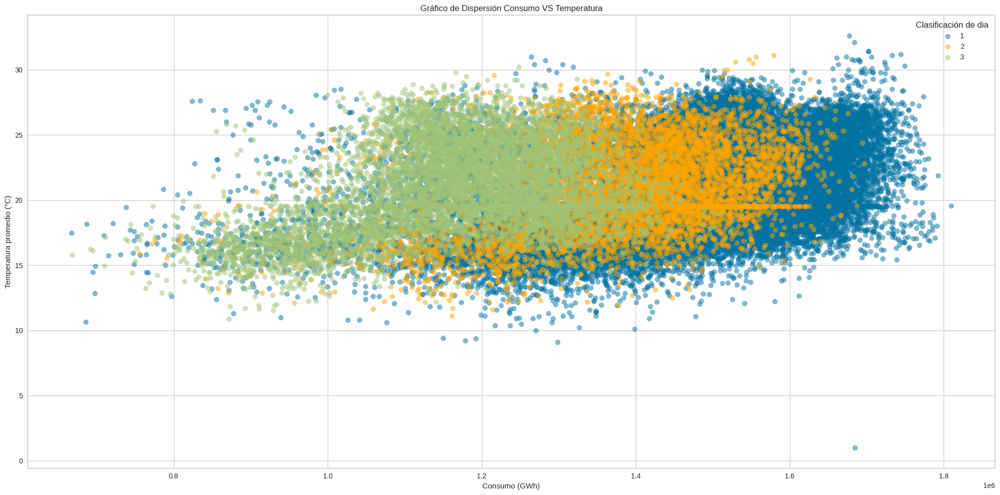

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k']

etiquetas = data_consumo_simplificado['tipo_dia'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo_simplificado[data_consumo_simplificado['tipo_dia'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Clasificación de dia')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

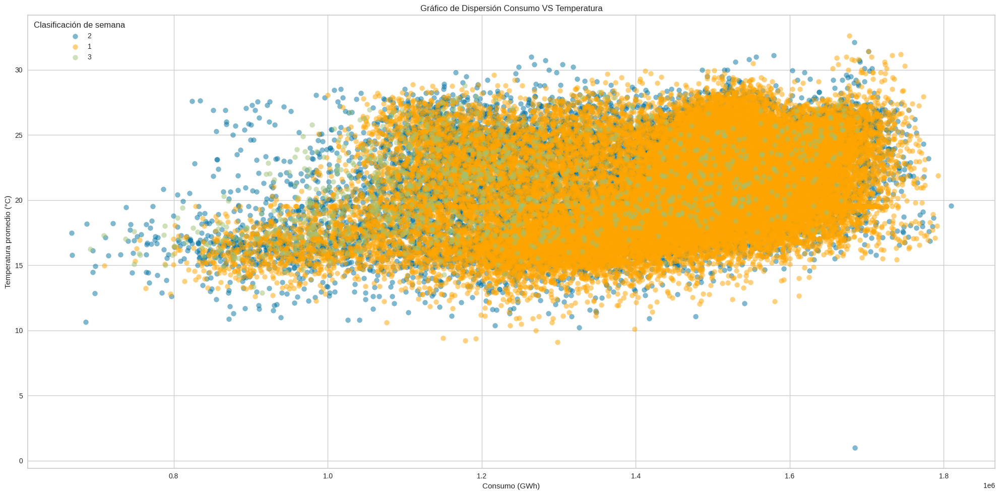

In [ ]:
# Crear el gráfico de dispersión con etiquetas de la leyenda
plt.figure(figsize=(20, 10))

# Definir colores y etiquetas únicas para la leyenda
colores = colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k']

etiquetas = data_consumo_simplificado['tipo_semana'].unique()

# Iterar a través de las etiquetas y los colores para crear puntos y etiquetas correspondientes
for i, etiqueta in enumerate(etiquetas):
    subset = data_consumo_simplificado[data_consumo_simplificado['tipo_semana'] == etiqueta]
    plt.scatter(subset['consumo'], subset['temperatura_prom'], label=etiqueta, color=colores[i], s=50, alpha=0.5)

# Personalizar el gráfico
plt.title('Gráfico de Dispersión Consumo VS Temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend(title='Clasificación de semana')

# Mostrar el gráfico
plt.grid(True)
plt.tight_layout()
plt.show()

In [ ]:
# Crear el gráfico de dispersión 3D interactivo con Plotly
fig = px.scatter_3d(data_consumo_simplificado, x='consumo', y='temperatura_prom', z='dia_semana', color='tipo_dia', symbol='tipo_dia', opacity=0.5)

# Personalizar el gráfico
fig.update_layout(
    title='Gráfico de Dispersión Consumo VS Temperatura VS Horas',
    scene=dict(
        xaxis_title='Consumo (GWh)',
        yaxis_title='Temperatura promedio (°C)',
        zaxis_title='Dia de la semama'
    )
)

# Mostrar el gráfico interactivo en Colab
fig.show()

In [ ]:
# Crear el gráfico de dispersión 3D interactivo con Plotly
fig = px.scatter_3d(data_consumo_simplificado, x='consumo', y='temperatura_prom', z='dia_semana', color='tipo_semana', opacity=0.5)

# Personalizar el gráfico
fig.update_layout(
    title='Gráfico de Dispersión Consumo VS Temperatura VS Horas',
    scene=dict(
        xaxis_title='Consumo (GWh)',
        yaxis_title='Temperatura promedio (°C)',
        zaxis_title='Dia de la semama'
    )
)

# Mostrar el gráfico interactivo en Colab
fig.show()

##### Encontrar cluster optimo

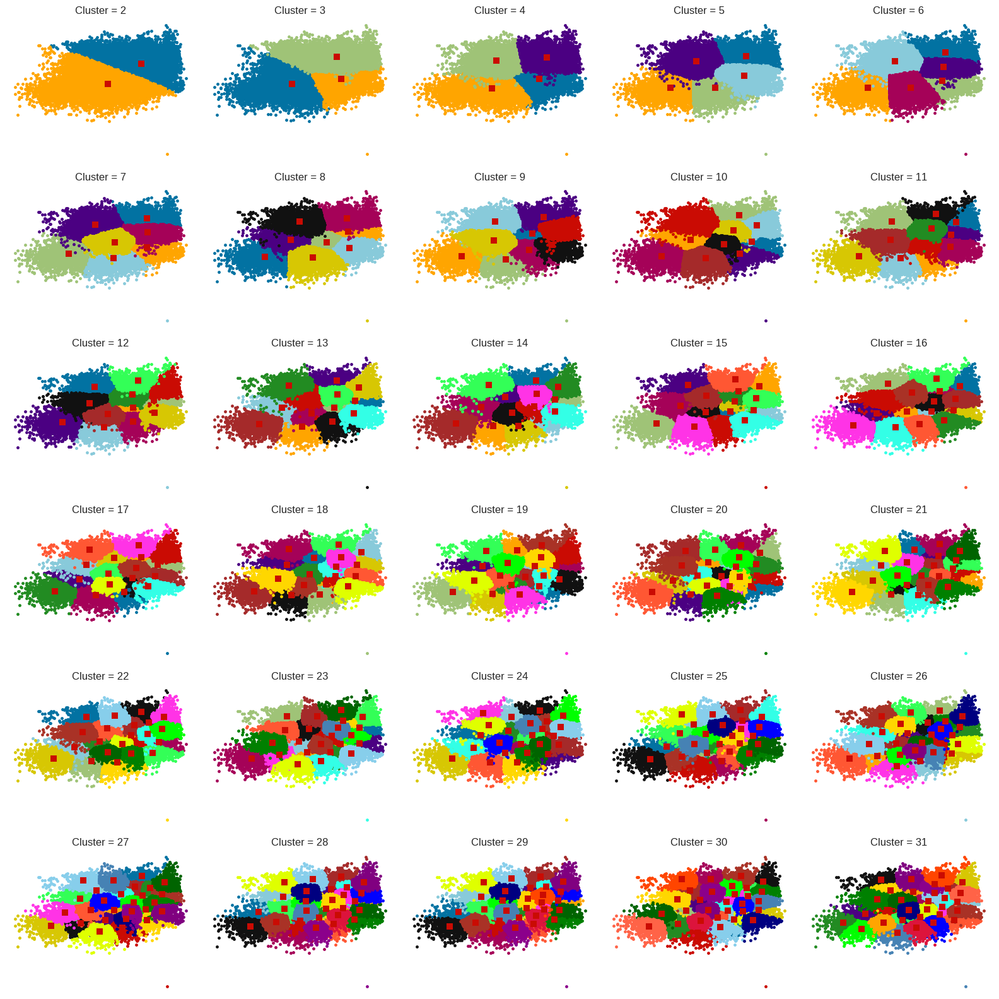

In [ ]:
x1 = X_norm['consumo']
x2 = X_norm['temperatura_prom']
feature_A = 0
feature_B = 1

fig1,axes1 = plt.subplots(6,5,figsize = (16,16))
error = 1e-4
max_iteraciones = 5000
colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k', 'r', 'Brown', 'ForestGreen',
        '#33FF57', '#33FFE6', '#FF33E6', '#FF5733', '#A93226', '#DFFF00', '#FFD700', '#00FF00', '#008000', '#006400', '#87CEEB', '#4682B4',
          '#0000FF', '#000080', '#800080', '#8B008B', '#DC143C', '#FF4500', '#FF6347', '#FFA500', '#FF8C00']

modelos = []
vector_clases = []
matriz_centros = []

silueta = []
calinski_harabasz = []
davies_bouldin = []

for ncenters, ax in enumerate(axes1.reshape(-1), 2):
  modelo_kmeans = KMeans(n_clusters = ncenters, max_iter = max_iteraciones, tol = error, random_state = 17)
  modelo_kmeans.fit(X_norm)
  clases = modelo_kmeans.labels_
  centros = modelo_kmeans.cluster_centers_
  modelos.append(modelo_kmeans)
  vector_clases.append(clases)
  matriz_centros.append(centros)

  silueta.append(silhouette_score(X_norm, clases))
  calinski_harabasz.append(calinski_harabasz_score(X_norm, clases))
  davies_bouldin.append(davies_bouldin_score(X_norm, clases))

  for j in range(ncenters):
    ax.plot(x1[clases == j], x2[clases == j], '.', color = colors[j])

  for pt in centros:
    ax.plot(pt[feature_A],pt[feature_B],'rs')

  ax.set_title('Cluster = {0}'.format(ncenters))
  ax.axis('off')

fig1.tight_layout()
plt.show()

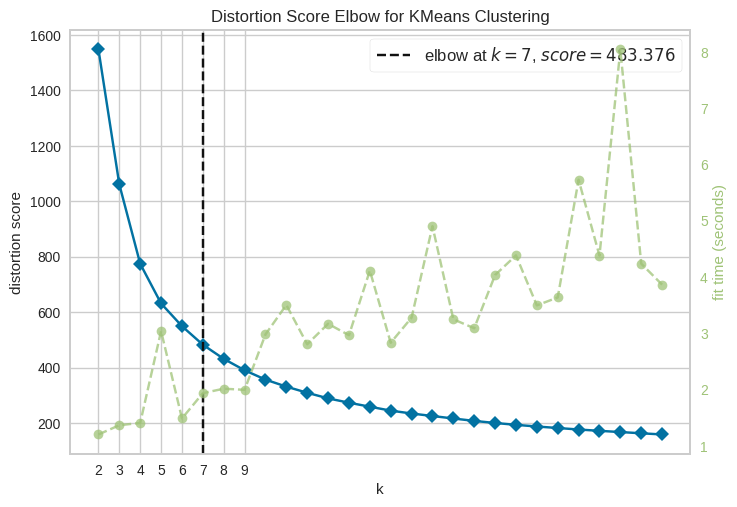

In [ ]:
fig, ax = plt.subplots()
elbow_graph = KElbowVisualizer(KMeans(max_iter = max_iteraciones, tol = error, random_state = 17),
                              k = (2, 30), ax = ax)
elbow_graph.fit(X_norm)
ax.set_xticks(range(2,10))
elbow_graph.show()
plt.show()

In [ ]:
# Define a range of K values
k_values = range(2, 30)
error = 1e-4
max_iteraciones = 5000

# Initialize lists to store silhouette scores for k-means and k-medoids
silhouette = []
calinski_harabasz = []
davies_bouldin = []

# Iterate through different K values
for k in k_values:
    # Initialize and fit KMeans
    kmeans = KMeans(n_clusters=k, max_iter = max_iteraciones, tol = error, random_state = 17)
    kmeans.fit(X_norm)

    clases = kmeans.labels_

    # Calculate silhouette scores for k-means and k-medoids
    silhouette.append(silhouette_score(X_norm, clases))
    calinski_harabasz.append(calinski_harabasz_score(X_norm, clases))
    davies_bouldin.append(davies_bouldin_score(X_norm, clases))


Text(0, 0.5, 'Silhouette Score')

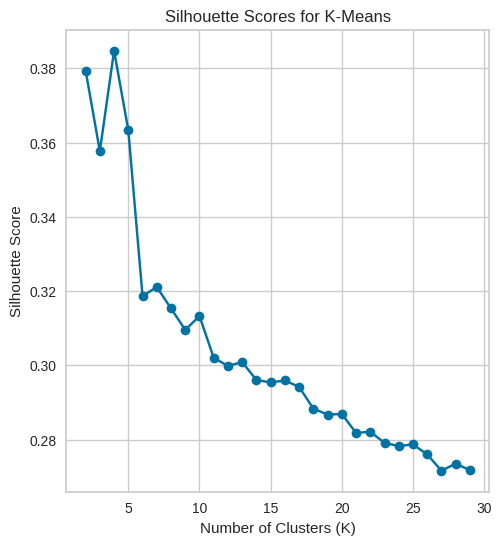

In [ ]:
# Plot silhouette scores for k-means
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(k_values, silhouette, marker='o', linestyle='-')
plt.title('Silhouette Scores for K-Means')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Silhouette Score')

Text(0, 0.5, 'Calinki Harabasz Score')

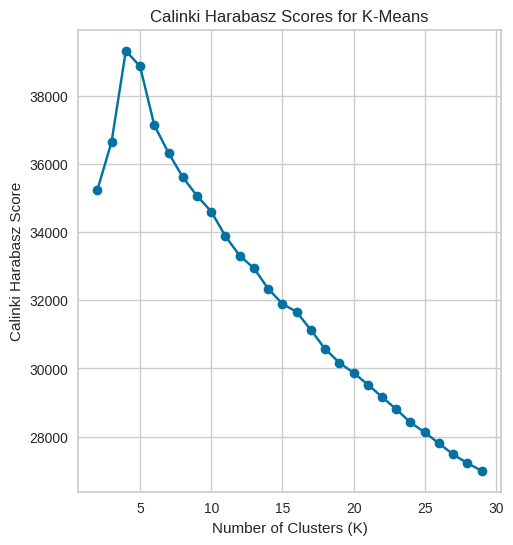

In [ ]:
# Plot Calinki Harabasz scores for k-means
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(k_values, calinski_harabasz, marker='o', linestyle='-')
plt.title('Calinki Harabasz Scores for K-Means')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Calinki Harabasz Score')

Text(0, 0.5, 'Davies Bouldin Score')

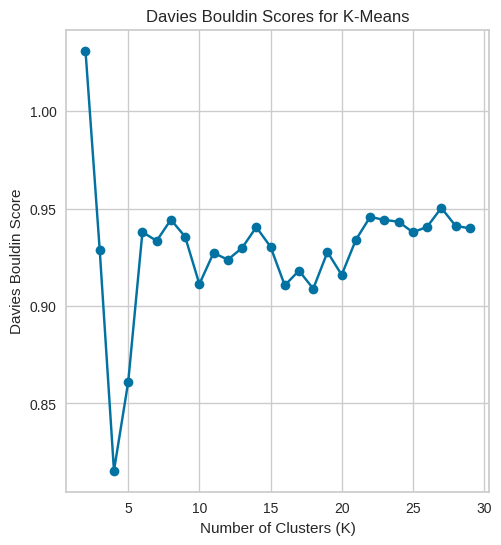

In [ ]:
# Plot Davies Bouldin scores for k-means
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(k_values, davies_bouldin, marker='o', linestyle='-')
plt.title('Davies Bouldin Scores for K-Means')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Davies Bouldin Score')

##### Graficos de cluster

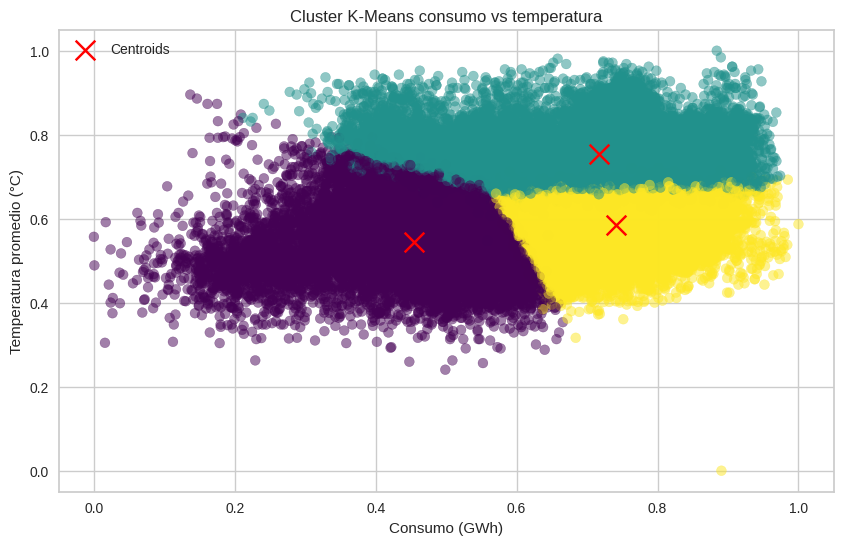

In [ ]:
# Aplica K-Means
n_clusters = 3  # Número de clústeres
kmeans = KMeans(n_clusters=n_clusters)
kmeans_labels = kmeans.fit_predict(X_norm_array)

# Obtiene los centroides de los clústeres
cluster_centers = kmeans.cluster_centers_

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=kmeans_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster K-Means consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

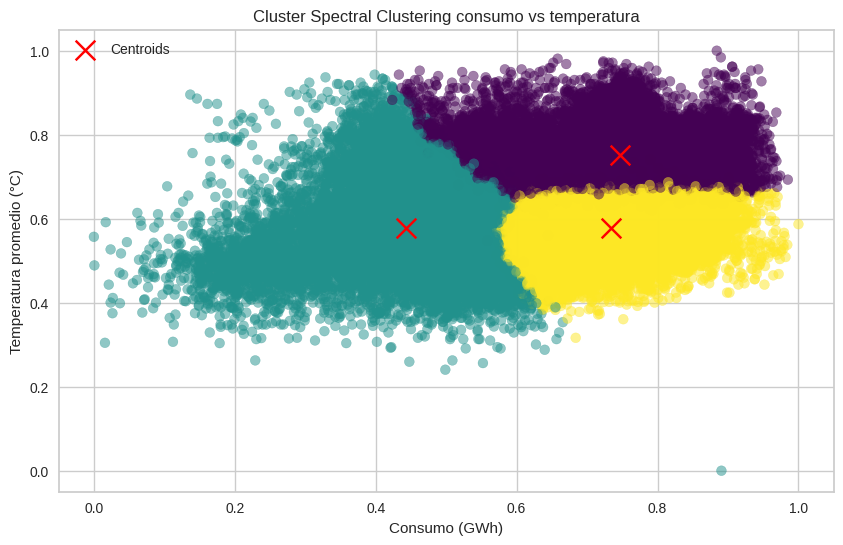

In [ ]:
# Aplica Spectral Clustering
n_clusters = 3  # Número de clústeres
spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', assign_labels='kmeans')
spectral_labels = spectral.fit_predict(X_norm_array)

# Calcula los centros de los clústeres
cluster_centers = []
for cluster in range(n_clusters):
    cluster_mask = spectral_labels == cluster
    cluster_center = np.mean(X_norm_array[cluster_mask], axis=0)
    cluster_centers.append(cluster_center)

cluster_centers = np.array(cluster_centers)

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=spectral_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster Spectral Clustering consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

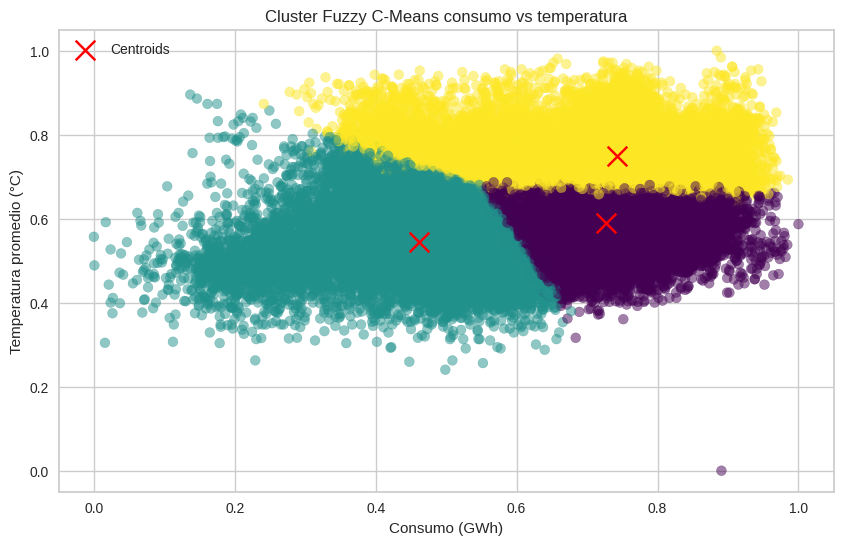

In [ ]:
# Aplica Fuzzy C-Means
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
    X_norm_array.T, n_clusters, m=2, error=0.005, maxiter=1000, init=None)

# Asigna cada punto a un clúster
cluster_membership = np.argmax(u, axis=0)

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=cluster_membership, cmap='viridis', s=50, alpha=0.5)
plt.scatter(cntr[:, 0], cntr[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.legend()
plt.title('Cluster Fuzzy C-Means consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.show()

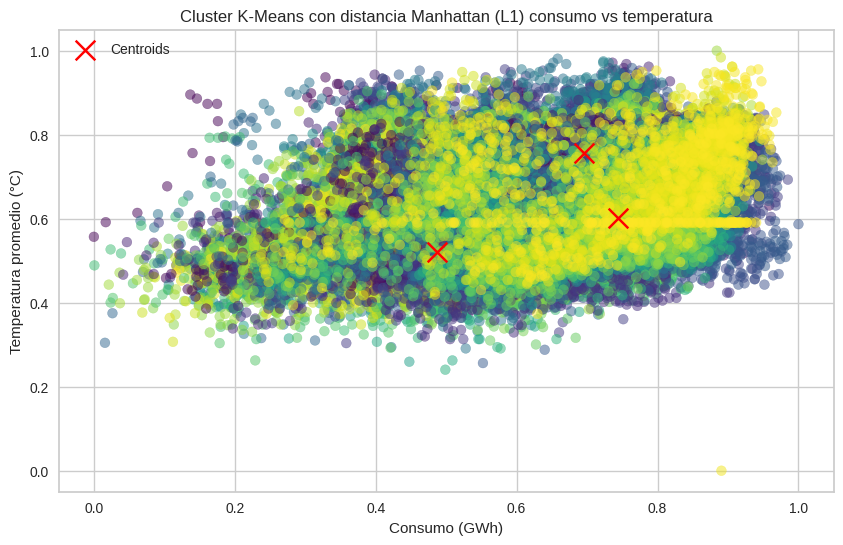

In [ ]:
# Define una métrica de distancia de Manhattan (L1)
manhattan_metric = distance_metric(type_metric.MANHATTAN)

# Inicializa K-Means
n_clusters = 3  # Número de clústeres
initial_centers = kmeans_plusplus_initializer(X_norm_array, n_clusters).initialize()
kmeans_instance = kmeans_(X_norm_array, initial_centers, metric=manhattan_metric)

# Ejecuta K-Means
kmeans_instance.process()
kmeans_labels = kmeans_instance.get_clusters()

# Obtiene los centroides de los clústeres
cluster_centers = np.array(kmeans_instance.get_centers())

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=np.hstack(kmeans_labels), cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster K-Means con distancia Manhattan (L1) consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

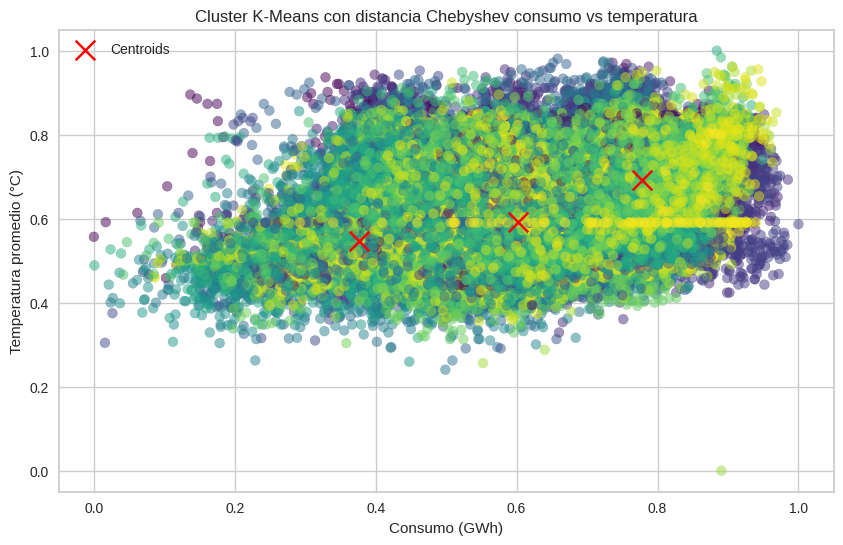

In [ ]:
# Define una función de distancia de Chebyshev (máxima diferencia en cada dimensión)
def chebyshev_distance(point1, point2):
    return max(abs(point1[i] - point2[i]) for i in range(len(point1)))

# Convierte la función de distancia personalizada en un tipo_metric
chebyshev_metric = distance_metric(type_metric.USER_DEFINED, func=chebyshev_distance)

# Inicializa K-Means
n_clusters = 3  # Número de clústeres
initial_centers = kmeans_plusplus_initializer(X_norm_array, n_clusters).initialize()
kmeans_instance = kmeans_(X_norm_array, initial_centers, metric=chebyshev_metric)

# Ejecuta K-Means
kmeans_instance.process()
kmeans_labels = kmeans_instance.get_clusters()

# Obtiene los centroides de los clústeres
cluster_centers = np.array(kmeans_instance.get_centers())

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=np.hstack(kmeans_labels), cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster K-Means con distancia Chebyshev consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

#### Cluster normales con PCA

In [ ]:
# Escalar datos
X = data_consumo_simplificado[['consumo', 'temperatura_mediana',	'temperatura_prom',	'temperatura_max']]

MM = MinMaxScaler(feature_range = (0,1))
X_norm_array = MM.fit_transform(X)
X_norm = pd.DataFrame(X_norm_array, columns = ['consumo','temperatura_mediana', 'temperatura_prom', 'temperatura_max'])

In [ ]:
# Crear una instancia de PCA con el número de componentes deseados
pca = PCA(n_components=2)

# Ajustar el modelo a tus datos y transformarlos
X_pca_array = pca.fit_transform(X_norm)

X_pca = pd.DataFrame(X_pca_array, columns = ['col1','col2'])

In [ ]:
X_pca

,col1,col2
0,0.544713,-0.404894
1,0.501599,-0.418902
2,0.437951,-0.413379
3,0.344189,-0.436363
4,0.233141,-0.482019
...,...,...
47740,-0.321341,0.005793
47741,-0.214117,0.019024
47742,-0.197158,0.111745
47743,-0.156688,0.132872


##### Encontrar cluster optimo

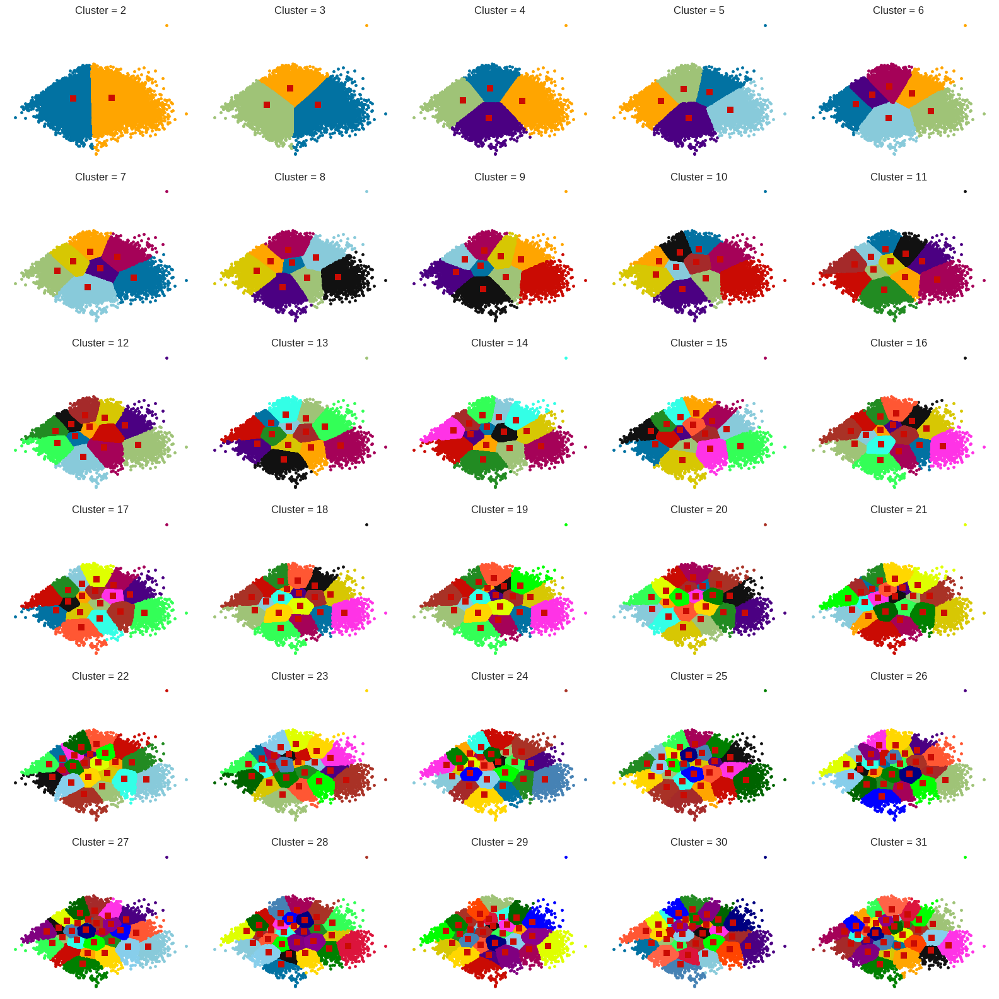

In [ ]:
x1 = X_pca['col1']
x2 = X_pca['col2']
feature_A = 0
feature_B = 1

fig1,axes1 = plt.subplots(6,5,figsize = (16,16))
error = 1e-4
max_iteraciones = 5000
colors = ['b', 'orange', 'g', 'indigo', 'c', 'm', 'y', 'k', 'r', 'Brown', 'ForestGreen',
        '#33FF57', '#33FFE6', '#FF33E6', '#FF5733', '#A93226', '#DFFF00', '#FFD700', '#00FF00', '#008000', '#006400', '#87CEEB', '#4682B4',
          '#0000FF', '#000080', '#800080', '#8B008B', '#DC143C', '#FF4500', '#FF6347', '#FFA500', '#FF8C00']

modelos = []
vector_clases = []
matriz_centros = []

silueta = []
calinski_harabasz = []
davies_bouldin = []

for ncenters, ax in enumerate(axes1.reshape(-1), 2):
  modelo_kmeans = KMeans(n_clusters = ncenters, max_iter = max_iteraciones, tol = error, random_state = 17)
  modelo_kmeans.fit(X_pca)
  clases = modelo_kmeans.labels_
  centros = modelo_kmeans.cluster_centers_
  modelos.append(modelo_kmeans)
  vector_clases.append(clases)
  matriz_centros.append(centros)

  silueta.append(silhouette_score(X_pca, clases))
  calinski_harabasz.append(calinski_harabasz_score(X_pca, clases))
  davies_bouldin.append(davies_bouldin_score(X_pca, clases))

  for j in range(ncenters):
    ax.plot(x1[clases == j], x2[clases == j], '.', color = colors[j])

  for pt in centros:
    ax.plot(pt[feature_A],pt[feature_B],'rs')

  ax.set_title('Cluster = {0}'.format(ncenters))
  ax.axis('off')

fig1.tight_layout()
plt.show()

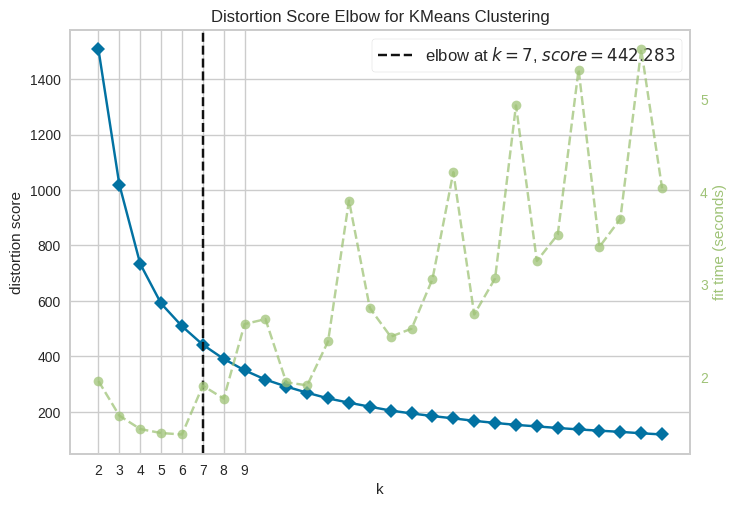

In [ ]:
fig, ax = plt.subplots()
elbow_graph = KElbowVisualizer(KMeans(max_iter = max_iteraciones, tol = error, random_state = 17),
                              k = (2, 30), ax = ax)
elbow_graph.fit(X_pca)
ax.set_xticks(range(2,10))
elbow_graph.show()
plt.show()

In [ ]:
# Define a range of K values
k_values = range(2, 30)
error = 1e-4
max_iteraciones = 5000

# Initialize lists to store silhouette scores for k-means and k-medoids
silhouette = []
calinski_harabasz = []
davies_bouldin = []

# Iterate through different K values
for k in k_values:
    # Initialize and fit KMeans
    kmeans = KMeans(n_clusters=k, max_iter = max_iteraciones, tol = error, random_state = 17)
    kmeans.fit(X_pca)

    clases = kmeans.labels_

    # Calculate silhouette scores for k-means and k-medoids
    silhouette.append(silhouette_score(X_pca, clases))
    calinski_harabasz.append(calinski_harabasz_score(X_pca, clases))
    davies_bouldin.append(davies_bouldin_score(X_pca, clases))


Text(0, 0.5, 'Silhouette Score')

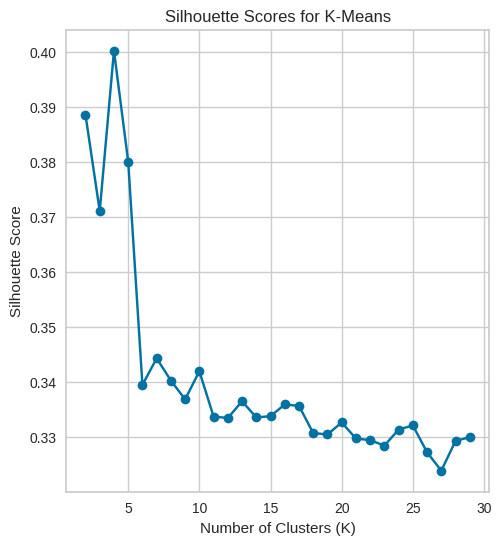

In [ ]:
# Plot silhouette scores for k-means
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(k_values, silhouette, marker='o', linestyle='-')
plt.title('Silhouette Scores for K-Means')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Silhouette Score')

Text(0, 0.5, 'Calinki Harabasz Score')

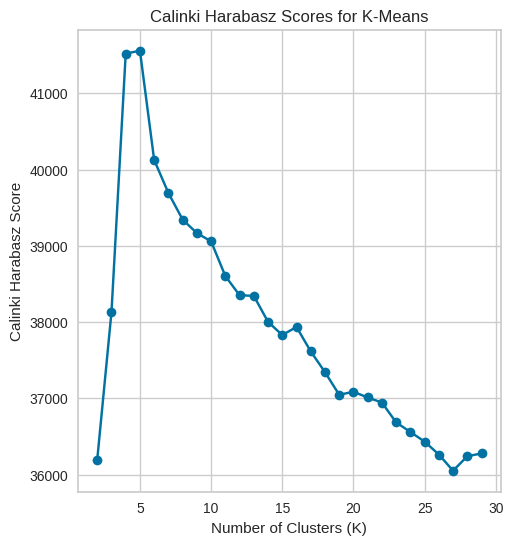

In [ ]:
# Plot Calinki Harabasz scores for k-means
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(k_values, calinski_harabasz, marker='o', linestyle='-')
plt.title('Calinki Harabasz Scores for K-Means')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Calinki Harabasz Score')

Text(0, 0.5, 'Davies Bouldin Score')

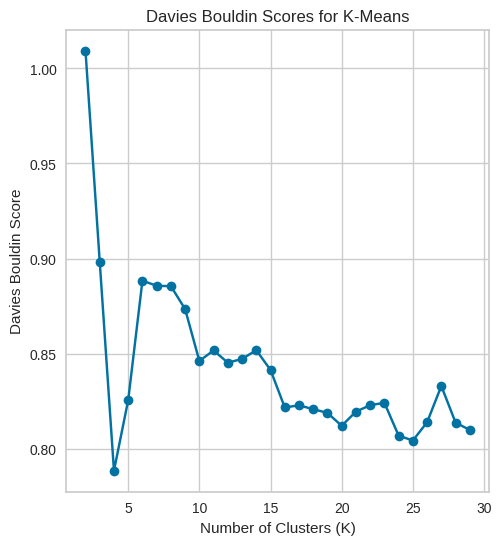

In [ ]:
# Plot Davies Bouldin scores for k-means
plt.figure(figsize=(12, 6))
plt.subplot(1, 2, 1)
plt.plot(k_values, davies_bouldin, marker='o', linestyle='-')
plt.title('Davies Bouldin Scores for K-Means')
plt.xlabel('Number of Clusters (K)')
plt.ylabel('Davies Bouldin Score')

##### Graficos de cluster

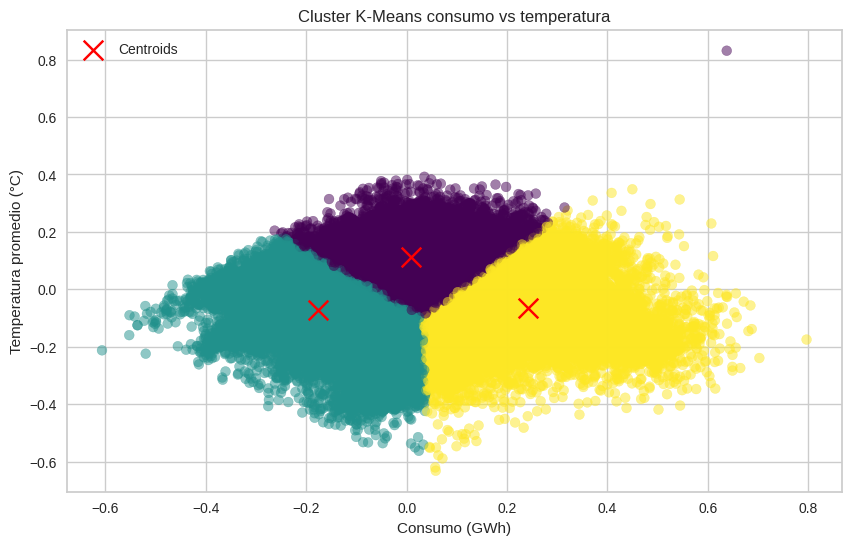

In [ ]:
# Aplica K-Means
n_clusters = 3  # Número de clústeres
kmeans = KMeans(n_clusters=n_clusters)
kmeans_labels = kmeans.fit_predict(X_pca_array)

# Obtiene los centroides de los clústeres
cluster_centers = kmeans.cluster_centers_

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_pca_array[:, 0], X_pca_array[:, 1], c=kmeans_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster K-Means consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

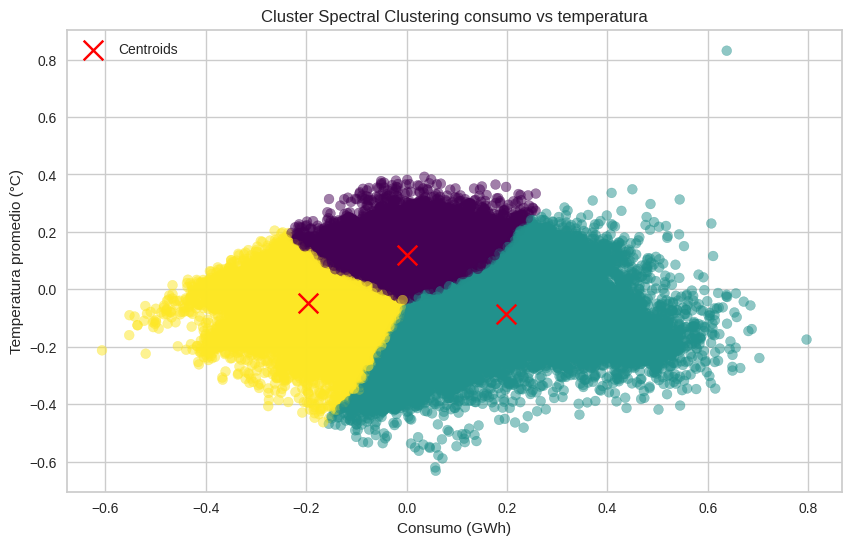

In [ ]:
# Aplica Spectral Clustering
n_clusters = 3  # Número de clústeres
spectral = SpectralClustering(n_clusters=n_clusters, affinity='nearest_neighbors', assign_labels='kmeans')
spectral_labels = spectral.fit_predict(X_pca_array)

# Calcula los centros de los clústeres
cluster_centers = []
for cluster in range(n_clusters):
    cluster_mask = spectral_labels == cluster
    cluster_center = np.mean(X_pca_array[cluster_mask], axis=0)
    cluster_centers.append(cluster_center)

cluster_centers = np.array(cluster_centers)

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_pca_array[:, 0], X_pca_array[:, 1], c=spectral_labels, cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster Spectral Clustering consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

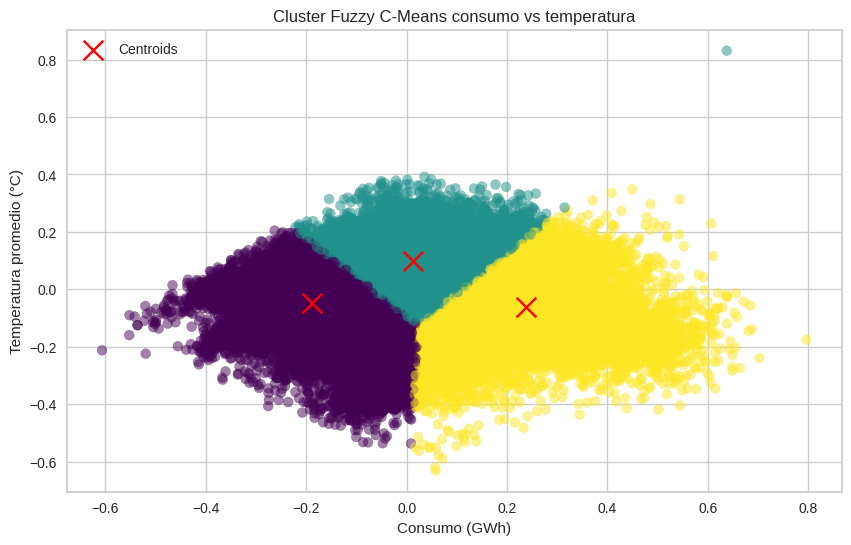

In [ ]:
# Aplica Fuzzy C-Means
cntr, u, u0, d, jm, p, fpc = fuzz.cluster.cmeans(
    X_pca_array.T, n_clusters, m=2, error=0.005, maxiter=1000, init=None)

# Asigna cada punto a un clúster
cluster_membership = np.argmax(u, axis=0)

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_pca_array[:, 0], X_pca_array[:, 1], c=cluster_membership, cmap='viridis', s=50, alpha=0.5)
plt.scatter(cntr[:, 0], cntr[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.legend()
plt.title('Cluster Fuzzy C-Means consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.show()


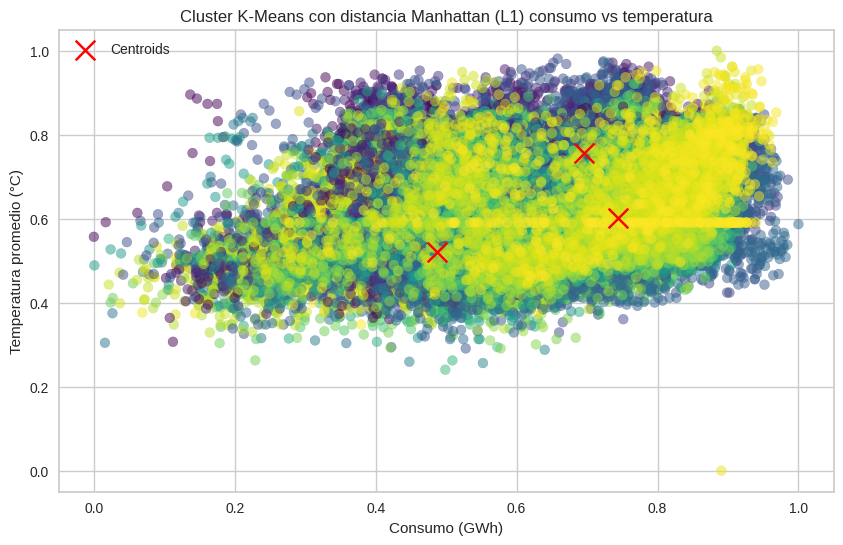

In [ ]:
# Define una métrica de distancia de Manhattan (L1)
manhattan_metric = distance_metric(type_metric.MANHATTAN)

# Inicializa K-Means
n_clusters = 3  # Número de clústeres
initial_centers = kmeans_plusplus_initializer(X_norm_array, n_clusters).initialize()
kmeans_instance = kmeans_(X_norm_array, initial_centers, metric=manhattan_metric)

# Ejecuta K-Means
kmeans_instance.process()
kmeans_labels = kmeans_instance.get_clusters()

# Obtiene los centroides de los clústeres
cluster_centers = np.array(kmeans_instance.get_centers())

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=np.hstack(kmeans_labels), cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster K-Means con distancia Manhattan (L1) consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

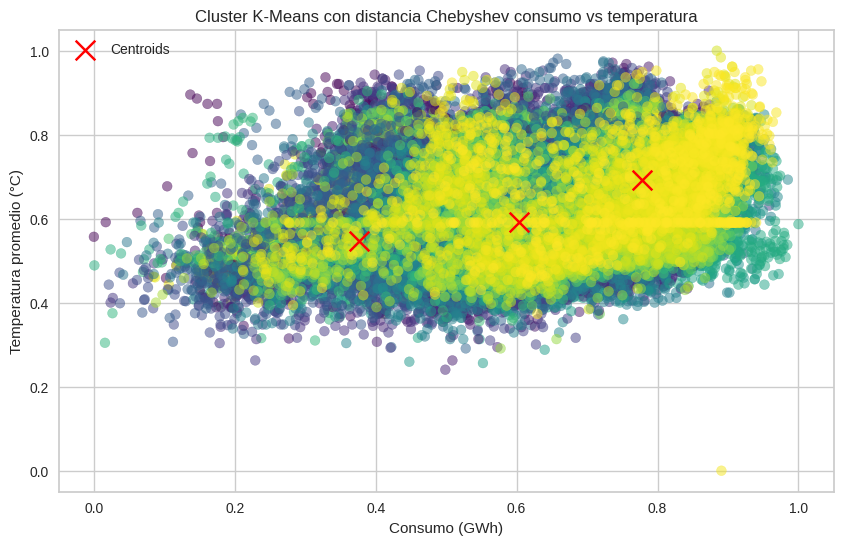

In [ ]:
# Define una función de distancia de Chebyshev (máxima diferencia en cada dimensión)
def chebyshev_distance(point1, point2):
    return max(abs(point1[i] - point2[i]) for i in range(len(point1)))

# Convierte la función de distancia personalizada en un tipo_metric
chebyshev_metric = distance_metric(type_metric.USER_DEFINED, func=chebyshev_distance)

# Inicializa K-Means
n_clusters = 3  # Número de clústeres
initial_centers = kmeans_plusplus_initializer(X_norm_array, n_clusters).initialize()
kmeans_instance = kmeans_(X_norm_array, initial_centers, metric=chebyshev_metric)

# Ejecuta K-Means
kmeans_instance.process()
kmeans_labels = kmeans_instance.get_clusters()

# Obtiene los centroides de los clústeres
cluster_centers = np.array(kmeans_instance.get_centers())

# Plot
plt.figure(figsize=(10, 6))
plt.scatter(X_norm_array[:, 0], X_norm_array[:, 1], c=np.hstack(kmeans_labels), cmap='viridis', s=50, alpha=0.5)
plt.scatter(cluster_centers[:, 0], cluster_centers[:, 1], c='red', marker='x', s=200, label='Centroids')
plt.title('Cluster K-Means con distancia Chebyshev consumo vs temperatura')
plt.xlabel('Consumo (GWh)')
plt.ylabel('Temperatura promedio (°C)')
plt.legend()
plt.show()

### Analisis de datos por dia

In [ ]:
data_dia = data_consumo[['consumo', 'fecha_hora', 'dia_semana', 'fin_de_semana', 'festivos']].copy(deep=True)
data_dia['fecha_hora'] = data_dia['fecha_hora'].dt.strftime('%Y-%m-%d')

data_dia = data_dia[['consumo', 'fecha_hora', 'dia_semana', 'fin_de_semana', 'festivos']].groupby(['fecha_hora', 'dia_semana', 'fin_de_semana', 'festivos']).agg({'consumo': 'sum'}).reset_index()

data_dia['fecha_hora'] = pd.to_datetime(data_dia['fecha_hora'])
data_dia = data_dia.set_index('fecha_hora').asfreq('D')

data_dia

,dia_semana,fin_de_semana,festivos,consumo
fecha_hora,,,,
2015-01-01,4,0,1,19914969
2015-01-02,5,0,0,24927110
2015-01-03,6,1,0,25075189
2015-01-04,7,1,0,23025687
2015-01-05,1,0,0,27400003
...,...,...,...,...
2023-09-14,4,0,0,36084417
2023-09-15,5,0,0,35784277
2023-09-16,6,1,0,33773923


#### Serie temporal

##### Visualización Visualización

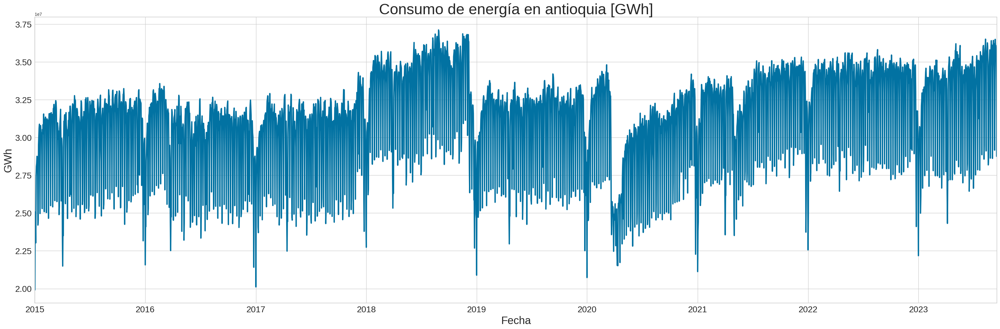

In [ ]:
# Visualización de la serie temporal
data_dia['consumo'].plot(figsize=(40, 12), linewidth=3)
plt.title('Consumo de energía en antioquia [GWh]', fontsize = 35)
plt.xlabel('Fecha', fontsize = 25)
plt.xticks(fontsize = 20)
plt.ylabel('GWh', fontsize = 25)
plt.yticks(fontsize = 20)
plt.show()

##### Descomposición estacional

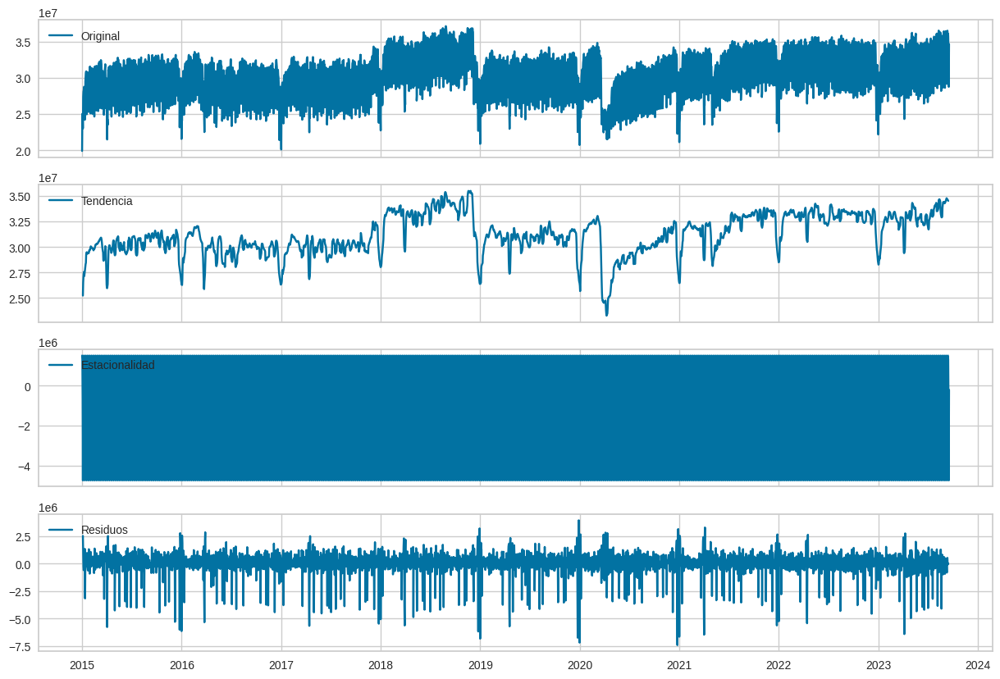

In [ ]:
# Identificación de tendencias
data_dia_descomposicion = sm.tsa.seasonal_decompose(data_dia['consumo'], model='additive')

data_dia_tendencia = data_dia_descomposicion.trend
data_dia_estacional = data_dia_descomposicion.seasonal
data_dia_residuo = data_dia_descomposicion.resid

fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_dia['consumo'], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_dia_tendencia, label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_dia_estacional, label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_dia_residuo,  label='Residuos')
axes[3].legend(loc='upper left');

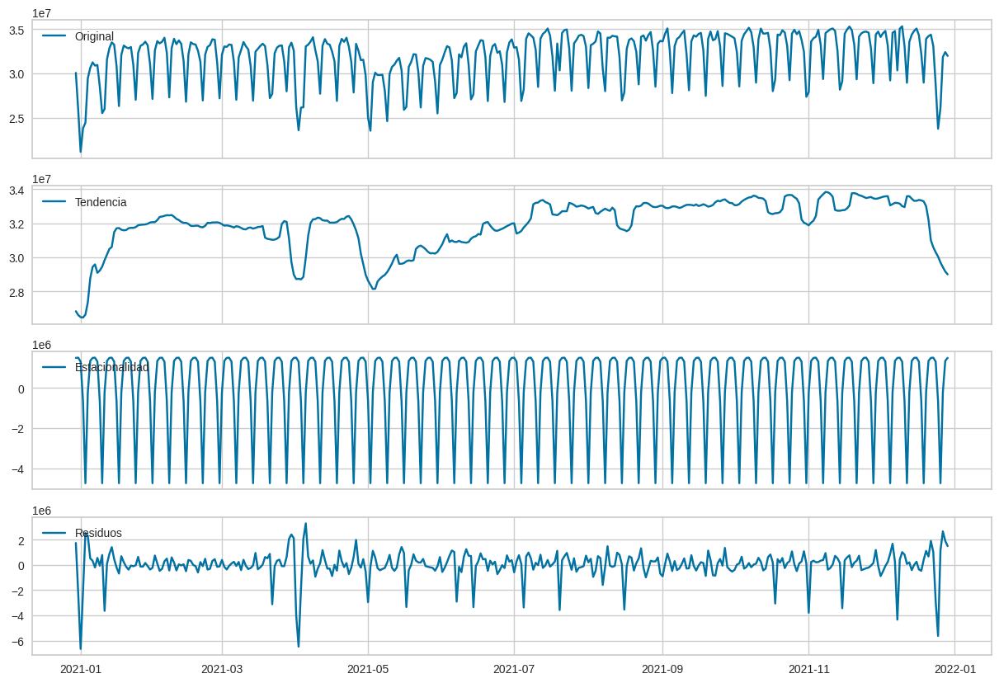

In [ ]:
# Identificación de tendencias en el año 2021
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_dia['consumo'][2190:2555], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_dia_tendencia[2190:2555], label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_dia_estacional[2190:2555], label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_dia_residuo[2190:2555], label='Residuos')
axes[3].legend(loc='upper left');

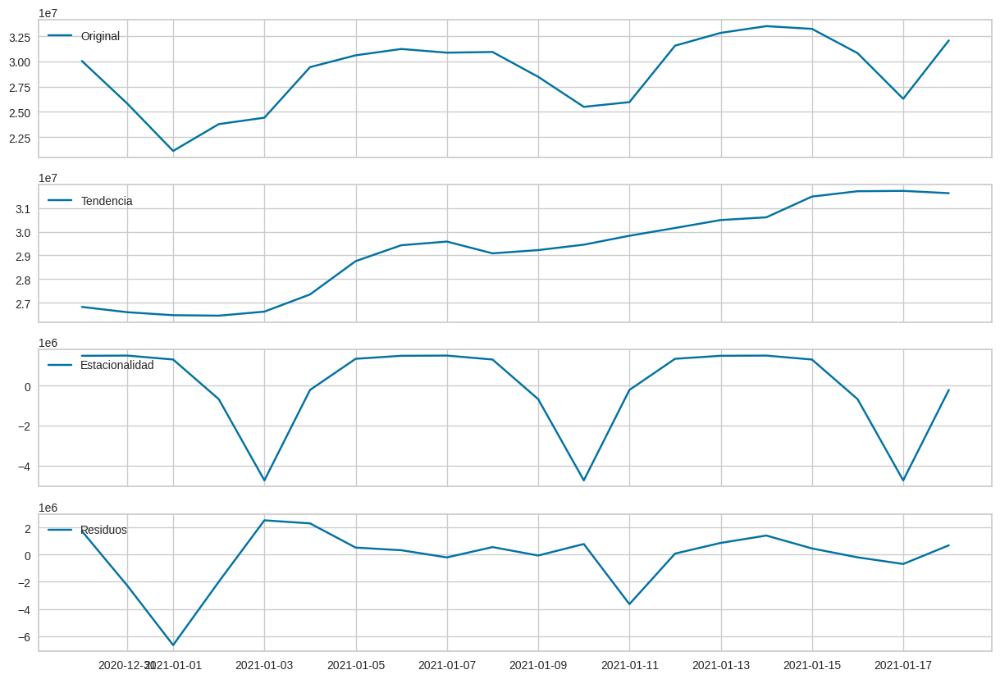

In [ ]:
# Identificación de tendencias en los primeros días del año 2021
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_dia['consumo'][2190:2210], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_dia_tendencia[2190:2210], label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_dia_estacional[2190:2210], label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_dia_residuo[2190:2210], label='Residuos')
axes[3].legend(loc='upper left');

#### Serie temporal de las diferencias

##### Visualización Visualización

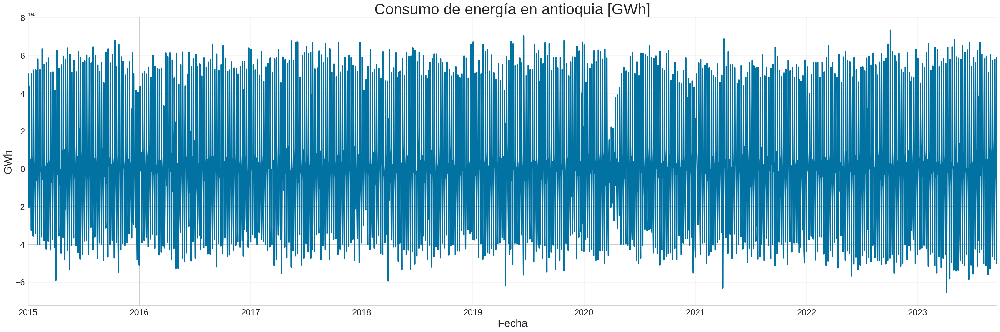

In [ ]:
# Visualización de la serie temporal
data_dia['consumo'].diff().plot(figsize=(40, 12), linewidth=3)
plt.title('Consumo de energía en antioquia [GWh]', fontsize = 35)
plt.xlabel('Fecha', fontsize = 25)
plt.xticks(fontsize = 20)
plt.ylabel('GWh', fontsize = 25)
plt.yticks(fontsize = 20)
plt.show()

##### Descomposición estacional

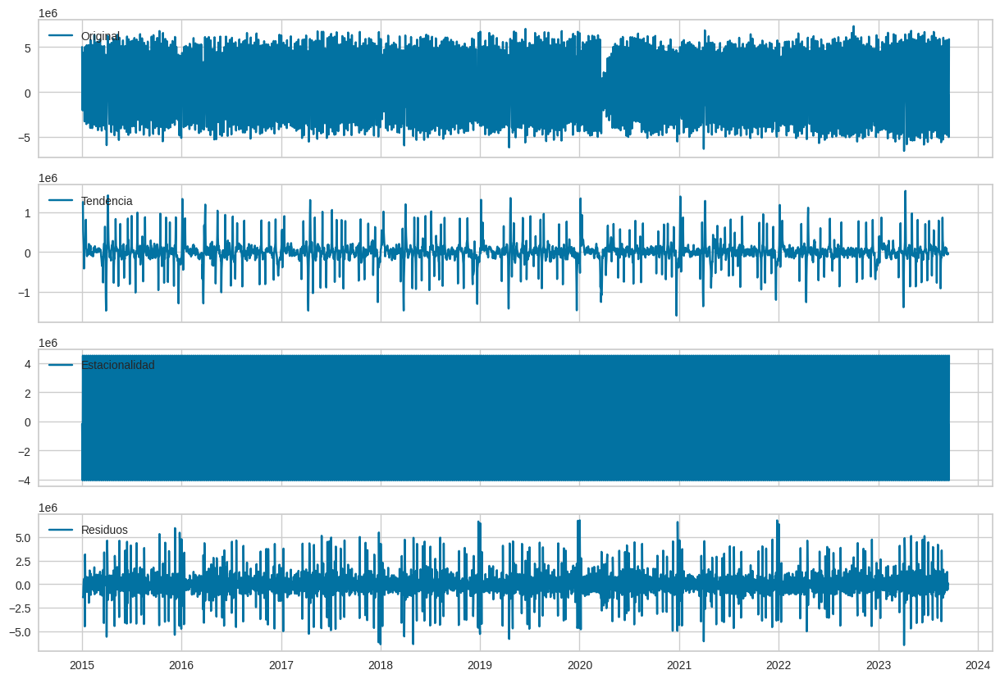

In [ ]:
# Identificación de tendencias
data_dia_descomposicion = sm.tsa.seasonal_decompose(data_dia['consumo'].diff().dropna(), model='additive')

data_dia_tendencia = data_dia_descomposicion.trend
data_dia_estacional = data_dia_descomposicion.seasonal
data_dia_residuo = data_dia_descomposicion.resid

fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_dia['consumo'].diff().dropna(), label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_dia_tendencia, label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_dia_estacional, label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_dia_residuo,  label='Residuos')
axes[3].legend(loc='upper left');

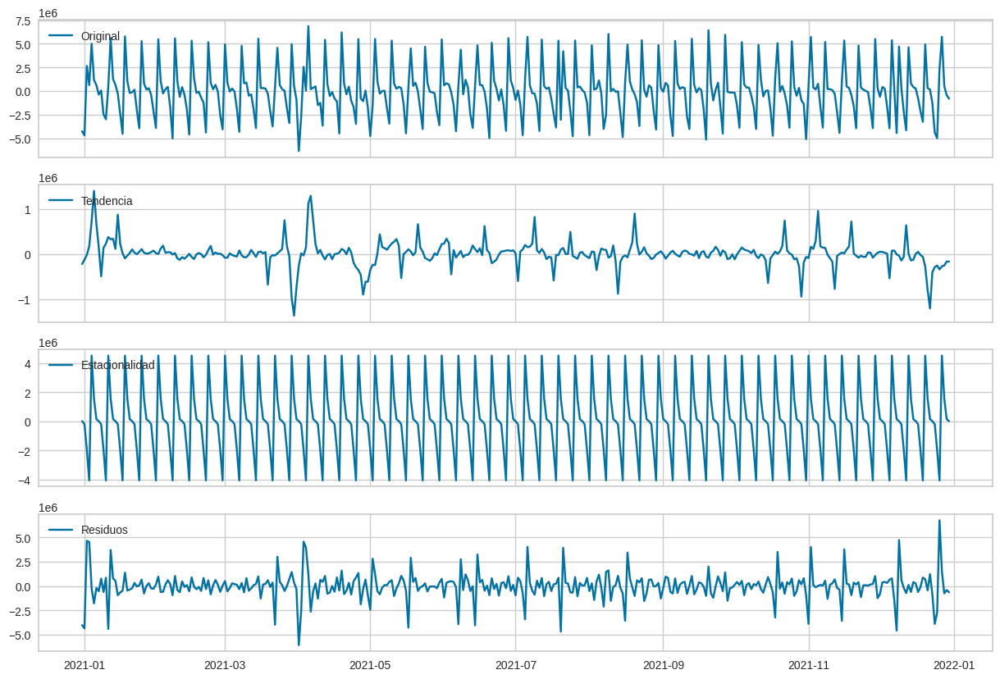

In [ ]:
# Identificación de tendencias en el año 2021
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_dia['consumo'].diff().dropna()[2190:2555], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_dia_tendencia[2190:2555], label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_dia_estacional[2190:2555], label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_dia_residuo[2190:2555], label='Residuos')
axes[3].legend(loc='upper left');

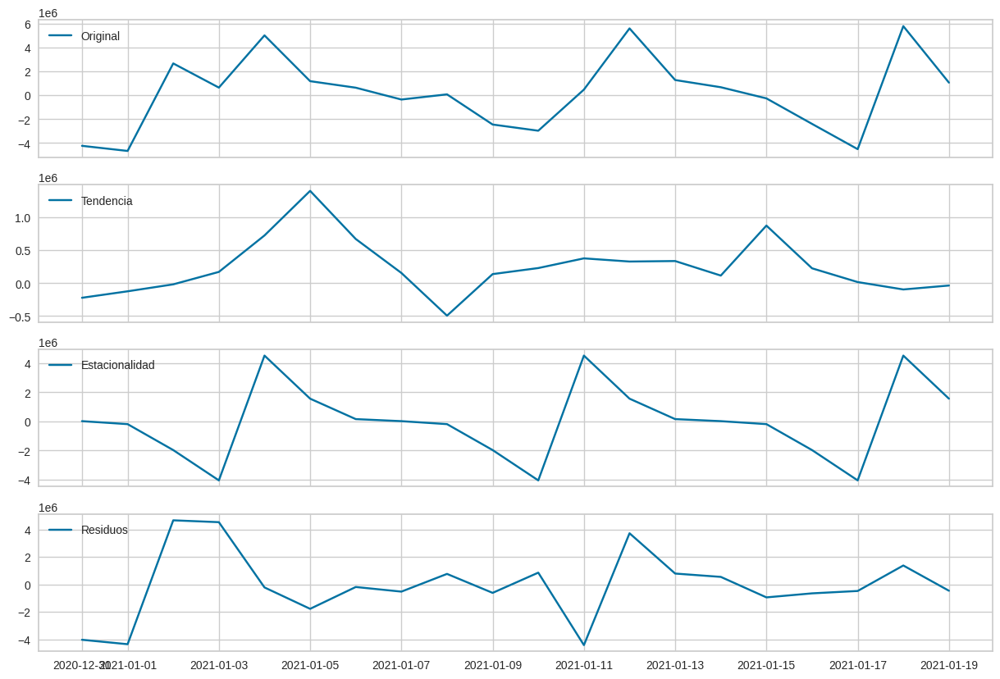

In [ ]:
# Identificación de tendencias en los primeros días del año 2021
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_dia['consumo'].diff().dropna()[2190:2210], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_dia_tendencia[2190:2210], label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_dia_estacional[2190:2210], label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_dia_residuo[2190:2210], label='Residuos')
axes[3].legend(loc='upper left');

### Analisis de datos por mes

In [ ]:
data_mes = data_consumo[['consumo', 'fecha_hora', 'mes']].copy(deep=True)
data_mes['fecha_hora'] = data_mes['fecha_hora'].dt.strftime('%Y-%m-%d')

data_mes = data_mes[['consumo', 'fecha_hora', 'mes']].groupby(['fecha_hora', 'mes']).agg({'consumo': 'sum'}).reset_index()

data_mes['fecha_hora'] = pd.to_datetime(data_mes['fecha_hora'])
data_mes = data_mes.set_index('fecha_hora').asfreq('M')

data_mes

,mes,consumo
fecha_hora,,
2015-01-31,1,29099944
2015-02-28,2,29665619
2015-03-31,3,29904365
2015-04-30,4,31046382
2015-05-31,5,24599547
...,...,...
2023-04-30,4,27701102
2023-05-31,5,34164408
2023-06-30,6,34629829


#### Serie temporal

##### Visualización Visualización

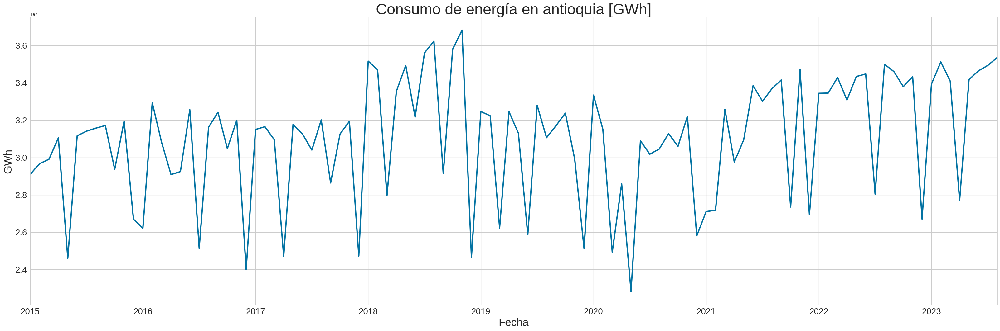

In [ ]:
# Visualización de la serie temporal
data_mes['consumo'].plot(figsize=(40, 12), linewidth=3)
plt.title('Consumo de energía en antioquia [GWh]', fontsize = 35)
plt.xlabel('Fecha', fontsize = 25)
plt.xticks(fontsize = 20)
plt.ylabel('GWh', fontsize = 25)
plt.yticks(fontsize = 20)
plt.show()

##### Descomposición estacional

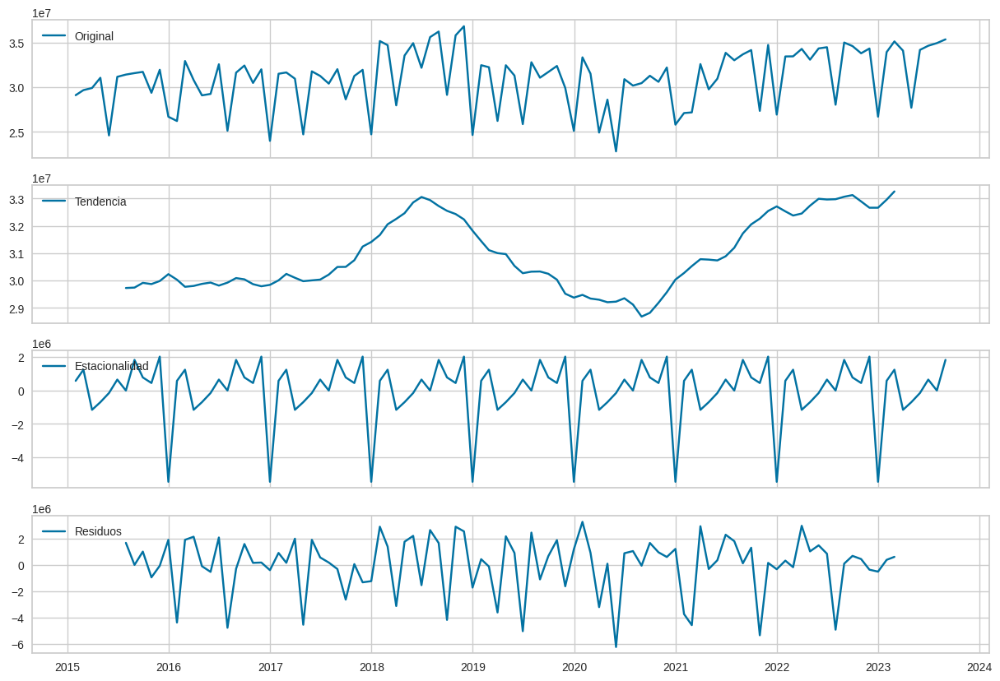

In [ ]:
# Identificación de tendencias
data_mes_descomposicion = sm.tsa.seasonal_decompose(data_mes['consumo'], model='additive')

data_mes_tendencia = data_mes_descomposicion.trend
data_mes_estacional = data_mes_descomposicion.seasonal
data_mes_residuo = data_mes_descomposicion.resid

fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_mes['consumo'], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_mes_tendencia, label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_mes_estacional, label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_mes_residuo,  label='Residuos')
axes[3].legend(loc='upper left');

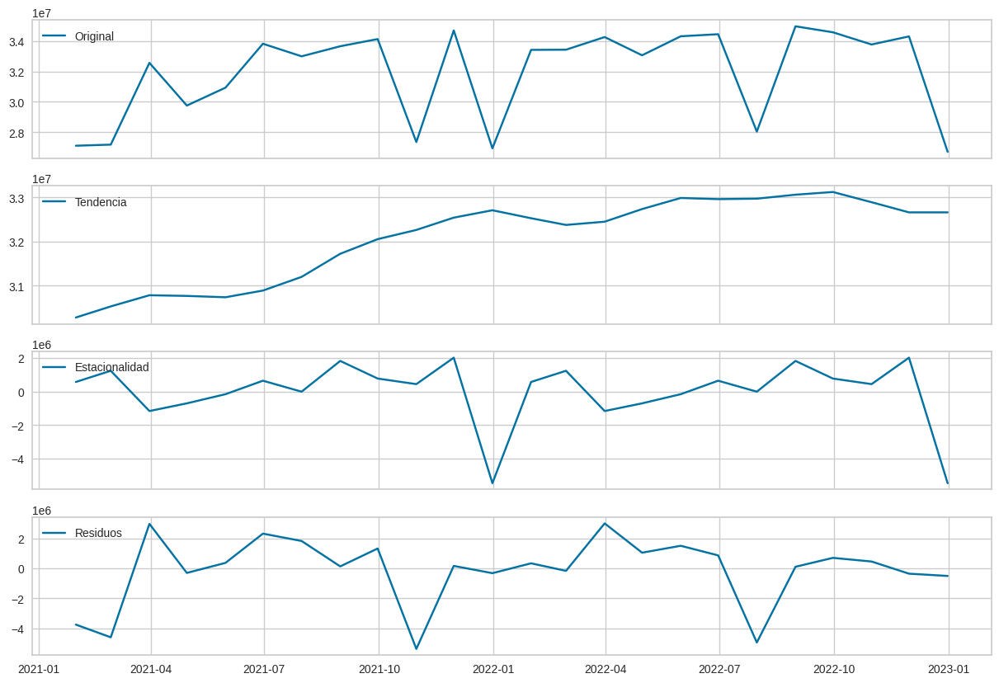

In [ ]:
# Identificación de tendencias en el año 2021
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_mes['consumo'][72:96], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_mes_tendencia[72:96], label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_mes_estacional[72:96], label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_mes_residuo[72:96], label='Residuos')
axes[3].legend(loc='upper left');

#### Serie temporal de las diferencias

##### Visualización Visualización

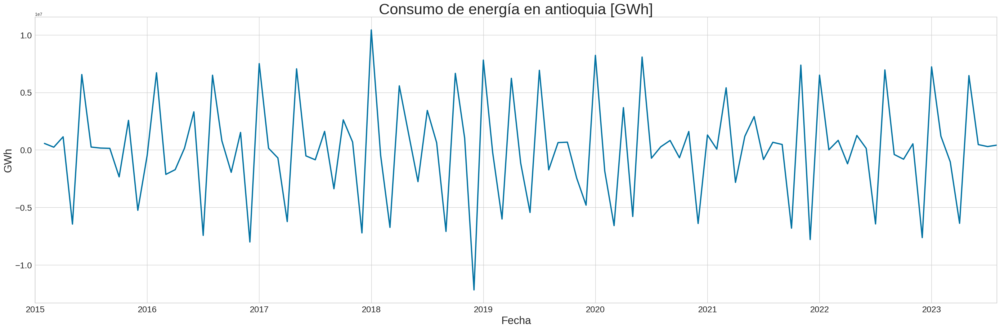

In [ ]:
# Visualización de la serie temporal
data_mes['consumo'].diff().plot(figsize=(40, 12), linewidth=3)
plt.title('Consumo de energía en antioquia [GWh]', fontsize = 35)
plt.xlabel('Fecha', fontsize = 25)
plt.xticks(fontsize = 20)
plt.ylabel('GWh', fontsize = 25)
plt.yticks(fontsize = 20)
plt.show()

##### Descomposición estacional

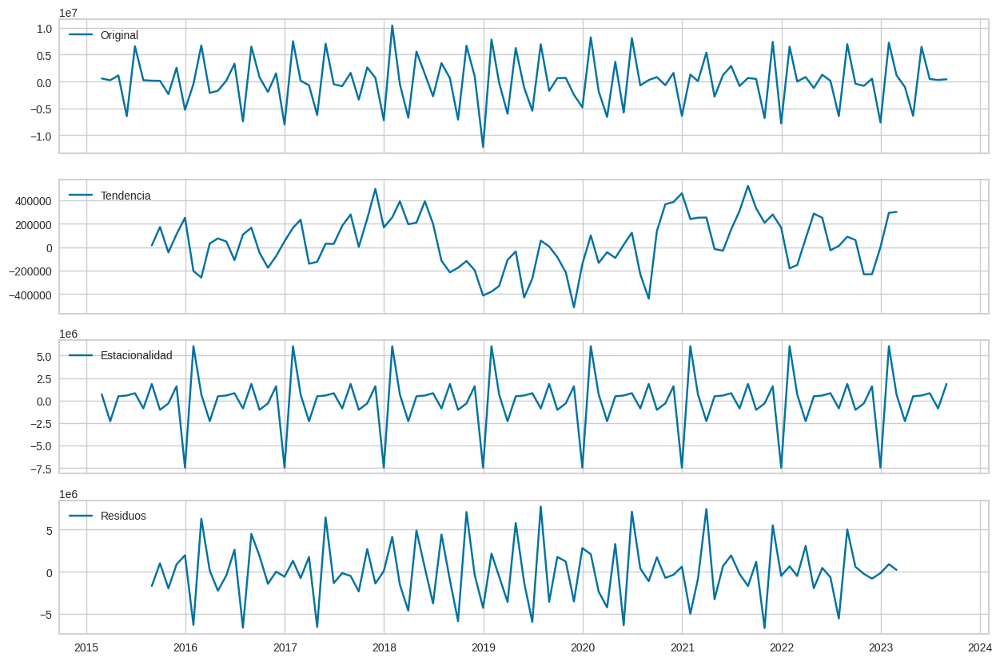

In [ ]:
# Identificación de tendencias
data_mes_descomposicion = sm.tsa.seasonal_decompose(data_mes['consumo'].diff().dropna(), model='additive')

data_mes_tendencia = data_mes_descomposicion.trend
data_mes_estacional = data_mes_descomposicion.seasonal
data_mes_residuo = data_mes_descomposicion.resid

fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_mes['consumo'].diff().dropna(), label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_mes_tendencia, label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_mes_estacional, label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_mes_residuo,  label='Residuos')
axes[3].legend(loc='upper left');

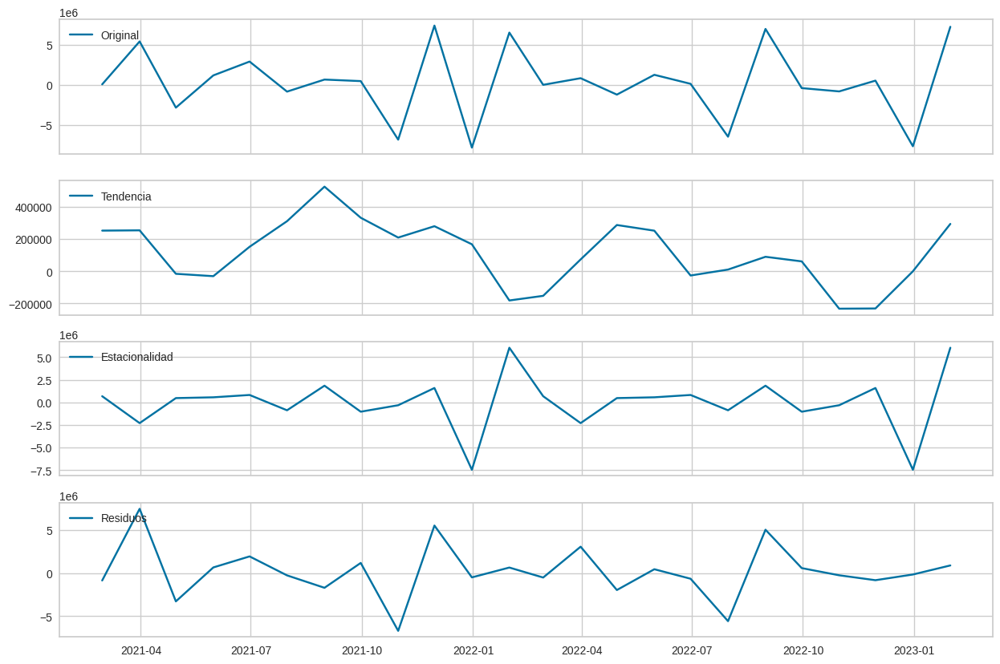

In [ ]:
# Identificación de tendencias en el año 2021
fig, axes = plt.subplots(4, 1, sharex=True, sharey=False)
fig.set_figheight(10)
fig.set_figwidth(15)

axes[0].plot(data_mes['consumo'].diff().dropna()[72:96], label='Original')
axes[0].legend(loc='upper left');

axes[1].plot(data_mes_tendencia[72:96], label='Tendencia')
axes[1].legend(loc='upper left');

axes[2].plot(data_mes_estacional[72:96], label='Estacionalidad')
axes[2].legend(loc='upper left');

axes[3].plot(data_mes_residuo[72:96], label='Residuos')
axes[3].legend(loc='upper left');

### Grafico de series de tiempo del consumo de energía eléctrica en Antioquia

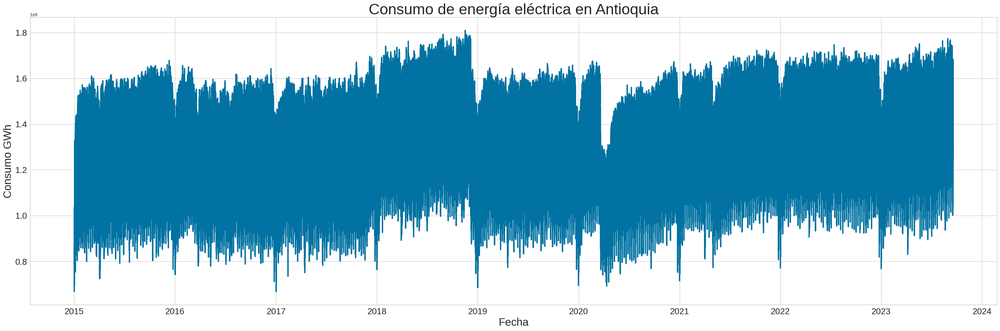

In [ ]:
plt.figure(figsize=(40,12))
plt.plot(data_consumo['fecha_hora'], data_consumo['consumo'], linewidth=3)
plt.title('Consumo de energía eléctrica en Antioquia', fontsize = 35)
plt.xlabel('Fecha', fontsize = 25)
plt.xticks(fontsize = 20)
plt.ylabel('Consumo GWh', fontsize = 25)
plt.yticks(fontsize = 20)
plt.show()

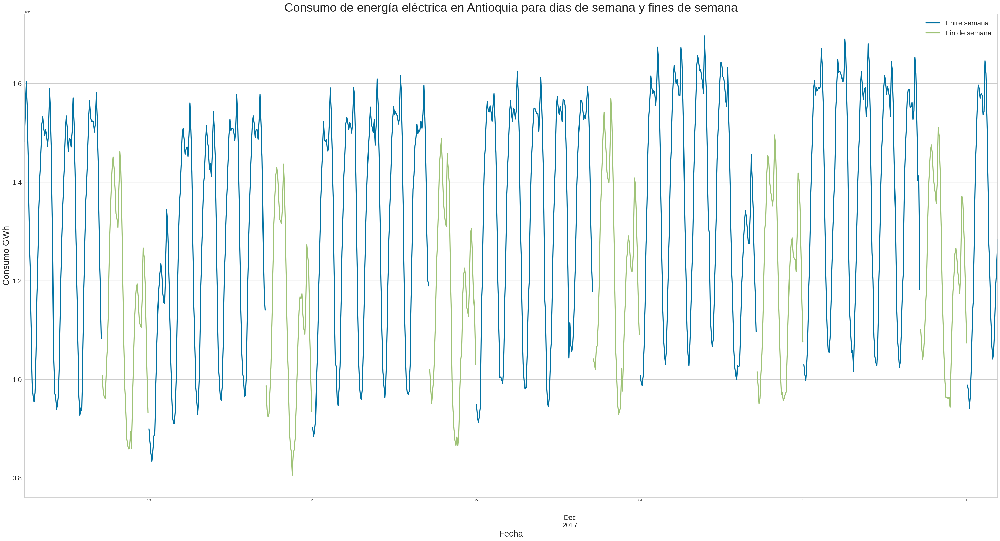

In [ ]:
df_consumo_antioquia_ = data_consumo.copy(deep=True)

df_consumo_antioquia_['fin_de_semana'] = np.where(df_consumo_antioquia_['fin_de_semana'] == 0, 'Entre semana', 'Fin de semana')
df_consumo_antioquia_ = df_consumo_antioquia_.pivot(index='fecha_hora', columns='fin_de_semana', values='consumo')

df_consumo_antioquia_.iloc[25000:26000].plot(figsize = (50, 25), linewidth = 3)
plt.title('Consumo de energía eléctrica en Antioquia para dias de semana y fines de semana', fontsize = 35)
plt.xlabel('Fecha', fontsize = 25)
plt.xticks(fontsize = 20)
plt.ylabel('Consumo GWh', fontsize = 25)
plt.yticks(fontsize = 20)
plt.legend(fontsize = 20)
plt.show()